### Visualize the PHOCNet results with BCE logit loss

In [1]:
import argparse
import logging

import numpy as np
import torch.autograd
import torch.cuda
import torch.nn as nn
import torch.optim
from torch.utils.data import DataLoader
import tqdm

import copy
from datasets.maps_alt import MAPSDataset

#from cnn_ws.transformations.homography_augmentation import HomographyAugmentation
from cnn_ws.losses.cosine_loss import CosineLoss

from cnn_ws.models.myphocnet import PHOCNet
from cnn_ws.evaluation.retrieval import map_from_feature_matrix, map_from_query_test_feature_matrices
from torch.utils.data.dataloader import _DataLoaderIter as DataLoaderIter
from torch.utils.data.sampler import WeightedRandomSampler

from cnn_ws.utils.save_load import my_torch_save, my_torch_load

#import matplotlib.pyplot as plt

In [2]:
# def learning_rate_step_parser(lrs_string):
#     return [(int(elem.split(':')[0]), float(elem.split(':')[1])) for elem in lrs_string.split(',')]

In [3]:
# # parameters
# embedding_type = 'phoc'
# phoc_unigram_levels = [1,2,4,8]
# fixed_image_size = None
# min_image_width_height = 26

In [4]:
# f = open('../splits/val_files.txt', 'rb')
# all_files = f.readlines()
# all_files = [x.strip('\n') for x in all_files]
# f.close()

# test_set = MAPSDataset(map_root_dir1='../../words/original_images/nopad/',
#                 map_root_dir2='../../words/original_words/nopad/',
#                 all_files=all_files,
#                 embedding=embedding_type,
#                 phoc_unigram_levels=phoc_unigram_levels,
#                 fixed_image_size=fixed_image_size,
#                 min_image_width_height=min_image_width_height)

In [5]:
if not torch.cuda.is_available():
    logger.warning('Could not find CUDA environment, using CPU mode')
    gpu_id = None
else:
    gpu_id = [0]
#torch.cuda.get_device_name(gpu_id[0])
pass

In [6]:
# test_set.mainLoader(partition='test', transforms=None)

NameError: name 'test_set' is not defined

In [7]:
# test_loader = DataLoader(test_set,
#     batch_size=1,
#     shuffle=False,
#     num_workers=8)

In [8]:
# save the model in new format so its easy to read
#model_ = torch.load('PHOCNet.pt')
#model_parameters = {name : param.data for name, param in model_.named_parameters()}
#torch.save(model_parameters, 'PHOCNet_new.pt')

In [9]:
# cnn = PHOCNet(n_out=list(test_set[0][1].size())[0],
#     input_channels=3,
#     gpp_type='gpp',
#     pooling_levels=([1], [5]))

# cnn.init_weights()

# #print list(cnn.named_parameters())
# pass

In [10]:
# '''
# my_torch_load(cnn, 'PHOCNet_new.pt')

# if gpu_id is not None:
#         if len(gpu_id) > 1:
#             cnn = nn.DataParallel(cnn, device_ids=gpu_id)
#             cnn.cuda()
#         else:
#             cnn.cuda(gpu_id[0])
# '''
# pass
# #print list(cnn.named_parameters())

In [33]:
model_ = torch.load('PHOCNet_a.pt')
cnn = model_.module#list(model_.named_parameters())
if gpu_id is not None:
        if len(gpu_id) > 1:
            cnn = nn.DataParallel(cnn, device_ids=gpu_id)
            cnn.cuda()
        else:
            cnn.cuda(gpu_id[0])
cnn.training = False

In [34]:
# def evaluate_cnn(cnn, dataset_loader, gpu_id):
#     logger = logging.getLogger('PHOCNet-Experiment::test')
#     # set the CNN in eval mode
#     cnn.eval()
#     logger.info('Computing net output:')
#     qry_ids = [] #np.zeros(len(dataset_loader), dtype=np.int32)
#     class_ids = np.zeros(len(dataset_loader), dtype=np.int32)
#     embedding_size = dataset_loader.dataset.embedding_size()
#     embeddings = np.zeros((len(dataset_loader), embedding_size), dtype=np.float32)
#     outputs = np.zeros((len(dataset_loader), embedding_size), dtype=np.float32)
#     eq = []
#     for sample_idx, (word_img, embedding, class_id, is_query) in enumerate(tqdm.tqdm(dataset_loader)):
#         #print(word_img.shape)
#         if len(word_img.shape) > 4:
#             #word_img = np.squeeze(word_img, axis=0)
#             word_img = word_img[0]
#         #print(word_img.shape)
#         if gpu_id is not None:
#             # in one gpu!!
#             word_img = word_img.cuda(gpu_id[0])
#             embedding = embedding.cuda(gpu_id[0])
#             #word_img, embedding = word_img.cuda(args.gpu_id), embedding.cuda(args.gpu_id)
        
#         word_img = torch.autograd.Variable(word_img)
#         embedding = torch.autograd.Variable(embedding)
#         ''' BCEloss ??? '''
#         output = torch.sigmoid(cnn(word_img))
#         #output = cnn(word_img)
#         outputs[sample_idx] = output.data.cpu().numpy().flatten()
#         embeddings[sample_idx] = embedding.data.cpu().numpy().flatten()
#         class_ids[sample_idx] = class_id.numpy()[0,0]
#         #eq = []
#         if is_query[0] == 1:
#             qry_ids.append(sample_idx)  #[sample_idx] = is_query[0]
#             eq.append(embeddings[sample_idx])

#     '''
#     # find queries

#     unique_class_ids, counts = np.unique(class_ids, return_counts=True)
#     qry_class_ids = unique_class_ids[np.where(counts > 1)[0]]

#     # remove stopwords if needed
    
#     qry_ids = [i for i in range(len(class_ids)) if class_ids[i] in qry_class_ids]
#     '''

#     qry_outputs = outputs[qry_ids][:]
#     qry_class_ids = class_ids[qry_ids]

#     # run word spotting
#     logger.info('Computing mAPs...')

#     ave_precs_qbe = map_from_query_test_feature_matrices(query_features = qry_outputs,
#                                                          test_features=outputs,
#                                                          query_labels = qry_class_ids,
#                                                          test_labels=class_ids,
#                                                          metric='cosine',
#                                                          drop_first=True)

#     logger.info('mAP: %3.2f', np.mean(ave_precs_qbe[ave_precs_qbe > 0])*100)
#     print 'mAP: ', np.mean(ave_precs_qbe[ave_precs_qbe > 0])*100
#     return outputs, qry_ids, class_ids, eq

In [35]:
# # evaluation (checking if I was correct or not)
# outputs, qry_ids, class_ids, eq = evaluate_cnn(cnn=cnn,
#         dataset_loader=test_loader,
#         gpu_id=gpu_id)

In [36]:
# #print outputs.shape, len(qry_ids), class_ids.shape, len(eq)
# from scipy.spatial.distance import cdist, pdist, squareform
# def find_matches(outputs, eq, metric, k):
#     # find sthe best distance between the embeddings and the output of cnn and returns matches
#     dist_mat = cdist(XA=outputs, XB=eq, metric=metric)
#     retrieval_indices = np.argsort(dist_mat, axis=1)
#     #print retrieval_indices
#     q = retrieval_indices[:,:k]
#     #print q
#     p = np.arange(len(q))
#     print (np.sum(p==q)), float(len(q))
#     return float(np.sum(p==q))/float(len(q))

In [37]:
# matches_percent = find_matches(outputs=outputs[qry_ids], eq=np.asarray(eq), metric = 'euclidean', k=1)
# print 'the accuracy for k=1 is: '+str(matches_percent)

In [38]:
# find the file names
f = open('../splits/train_files.txt', 'rb')
A = f.readlines()
f.close()
A = [x.rstrip('\n') for x in A]

In [39]:
# load test images and words
images = np.load('../../../ProcessedData/original_images_nopad_'+A[2]+'.tiff.npy')
words = np.load('../../../ProcessedData/original_words_nopad_'+A[2]+'.tiff.npy')

In [40]:
print images.shape
print words.shape

(567, 135, 487, 3)
(567,)


In [41]:
# # increasing the length of the word list (do this only if necessary)
# words = list(words)
# for i in words:
#     words.append(i[1:])
#     words.append(i[:-1])
# words = np.array(words)

In [42]:
# convert dimensions
images = np.transpose(images, (0,3,1,2))
images.shape

(567, 3, 135, 487)

In [43]:
# check if this works
outputs = []
for i in range(len(images)):
    word_img = images[i]
    word_img = 1 - word_img.astype(np.float32) / 255.0
    word_img = word_img.reshape((1,) + word_img.shape)
    word_img = torch.from_numpy(word_img).float()
    word_img = word_img.cuda(gpu_id[0])
    word_img = torch.autograd.Variable(word_img)
    output = torch.sigmoid(cnn(word_img))
    output = output.data.cpu().numpy().flatten()
    outputs.append(output)

In [44]:
# compute the PHOC representation of the word itself
from cnn_ws.string_embeddings.phoc import build_phoc_descriptor
word_strings = words
unigrams = [chr(i) for i in range(ord('&'), ord('&')+1) + range(ord('A'), ord('Z')+1) + \
                    range(ord('a'), ord('z') + 1) + range(ord('0'), ord('9') + 1)]
bigram_levels = None
bigrams = None
phoc_unigram_levels=(1, 2, 4, 8)

# for i in range(len(word_strings)):
#     word_strings[i] = word_strings[i].lower()
    

embedding = build_phoc_descriptor(words=word_strings,
                                  phoc_unigrams=unigrams,
                                  bigram_levels=bigram_levels,
                                  phoc_bigrams=bigrams,
                                  unigram_levels=phoc_unigram_levels)

print embedding.shape

100%|██████████| 567/567 [00:00<00:00, 3015.17it/s]

(567, 945)


In [45]:
from scipy.spatial.distance import cdist, pdist, squareform

def report_matches(outputs, embedding, matching, word_strings, k, length):
    # length sorting stuff
    qualified_ids = [x for x in range(len(word_strings)) if len(word_strings[x]) > length]
    outputs = np.array(outputs)
    embedding = np.array(embedding)
    word_strings = np.array(word_strings)
    outputs = list(outputs[qualified_ids])
    embedding = list(embedding[qualified_ids])
    word_strings = list(word_strings[qualified_ids])
    # the real computation
    dist_mat = cdist(XA=outputs, XB=embedding, metric=matching)
    retrieval_indices = np.argsort(dist_mat, axis=1)
    q = retrieval_indices[:,:k]
    count = 0
    matched_words = []
    # get all matched words
    #print len(outputs), len(embedding)
    for i in range(len(q)):
        matched = []
        #print q[i]
        for j in q[i]:
            matched.append(word_strings[j])
        matched_words.append(matched)
    
    #print len(word_strings), len(matched_words)
    for i in range(len(word_strings)):
        #print word_strings[i]
        if word_strings[i] in matched_words[i]:
            count = count+1

    #q = np.squeeze(np.array(q))
    #p = np.arange(len(q))
    #print count
    return count, matched_words, outputs, embedding, word_strings, qualified_ids

D0041-5370006 the accuracy is: 0.478
************************************************************************
************************************************************************
Original image:


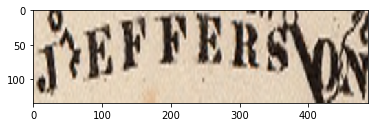

the matched words are (inorder): ['JEFFERSON']
ground truth: JEFFERSON
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


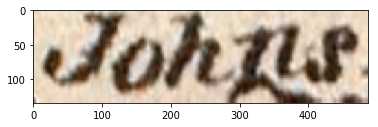

the matched words are (inorder): ['Aucilla']
ground truth: Johns
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


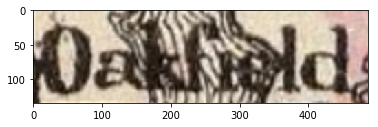

the matched words are (inorder): ['Naylor']
ground truth: Oakfield
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


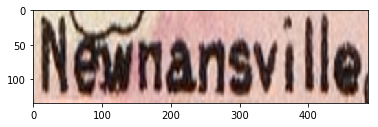

the matched words are (inorder): ['Newnansville']
ground truth: Newnansville
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


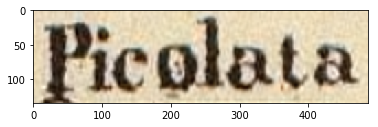

the matched words are (inorder): ['Picolata']
ground truth: Picolata
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


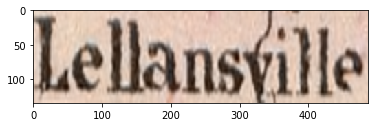

the matched words are (inorder): ['Lellansville']
ground truth: Lellansville
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


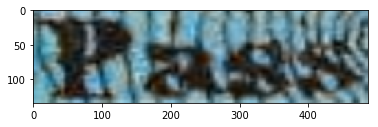

the matched words are (inorder): ['BROOKS']
ground truth: Pass
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


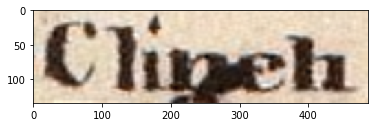

the matched words are (inorder): ['Clinch']
ground truth: Clinch
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


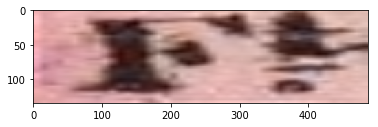

the matched words are (inorder): ['Bay']
ground truth: Ft.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


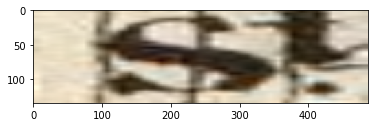

the matched words are (inorder): ['PINE']
ground truth: St.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


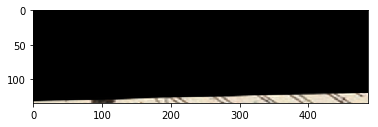

the matched words are (inorder): ['Vanswearingen']
ground truth: Map
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


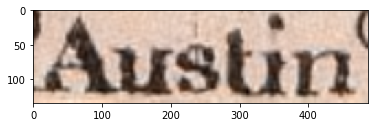

the matched words are (inorder): ['Austin']
ground truth: Austin
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


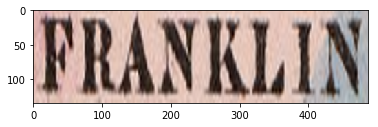

the matched words are (inorder): ['FRANKLIN']
ground truth: FRANKLIN
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


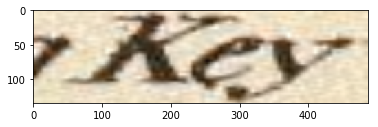

the matched words are (inorder): ['KEY']
ground truth: Key
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


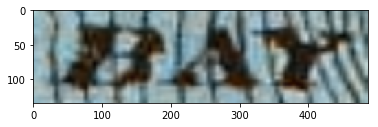

the matched words are (inorder): ['Ft.']
ground truth: BAY
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


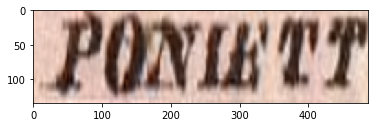

the matched words are (inorder): ['Pt.']
ground truth: PONIETT
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


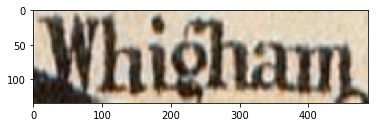

the matched words are (inorder): ['Whigham']
ground truth: Whigham
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


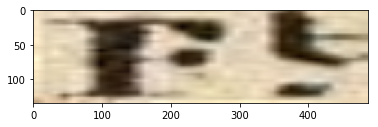

the matched words are (inorder): ['Ldg']
ground truth: Ft.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


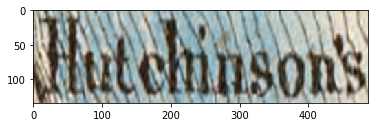

the matched words are (inorder): ['MONROE']
ground truth: Hutchinson's
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


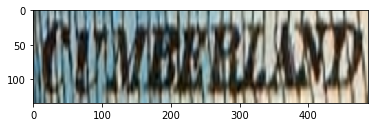

the matched words are (inorder): ['CUMBERLAND']
ground truth: CUMBERLAND
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


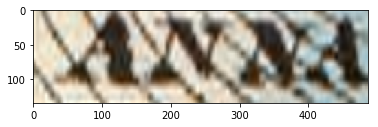

the matched words are (inorder): ['SANTA']
ground truth: ANNA
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


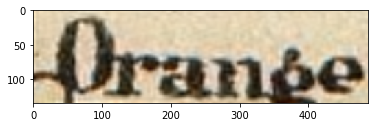

the matched words are (inorder): ['unreadable']
ground truth: Orange
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


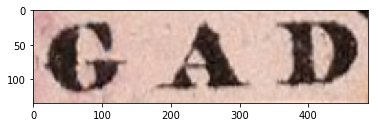

the matched words are (inorder): ['GAD']
ground truth: GAD
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


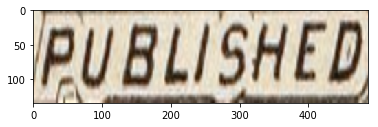

the matched words are (inorder): ['PUBLISHED']
ground truth: PUBLISHED
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


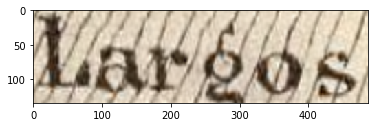

the matched words are (inorder): ['CALHOUN']
ground truth: Largos
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


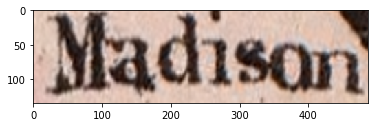

the matched words are (inorder): ['Madison']
ground truth: Madison
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


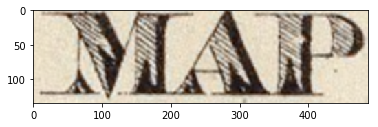

the matched words are (inorder): ['SWAMP']
ground truth: MAP
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


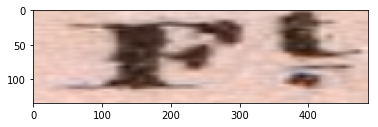

the matched words are (inorder): ['Log']
ground truth: Ft.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


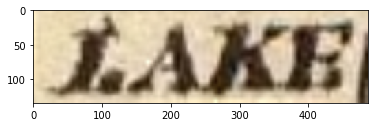

the matched words are (inorder): ['LAKE']
ground truth: LAKE
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


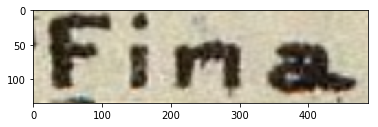

the matched words are (inorder): ['Florida']
ground truth: Fina
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


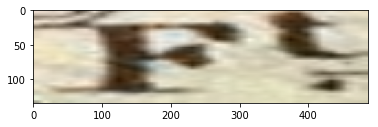

the matched words are (inorder): ['Pass']
ground truth: Ft.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


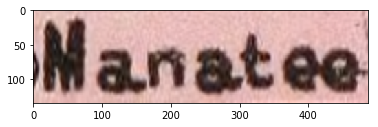

the matched words are (inorder): ['Manatee']
ground truth: Manatee
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


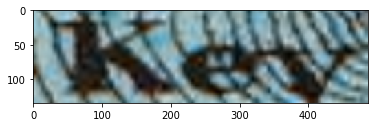

the matched words are (inorder): ['ISLANS']
ground truth: Key
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


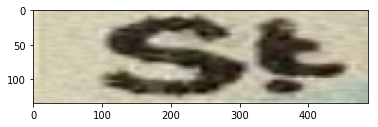

the matched words are (inorder): ['Vista']
ground truth: St.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


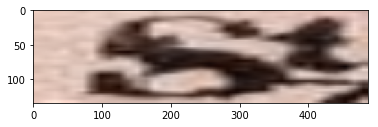

the matched words are (inorder): ['Whitesville']
ground truth: St.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


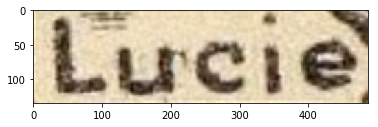

the matched words are (inorder): ['Lucie']
ground truth: Lucie
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


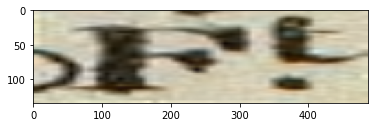

the matched words are (inorder): ['SUMTER']
ground truth: Ft.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


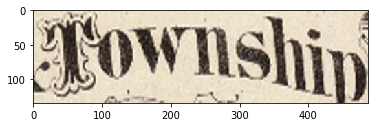

the matched words are (inorder): ['Township']
ground truth: Township
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


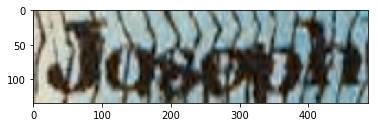

the matched words are (inorder): ['BROOKS']
ground truth: Joseph
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


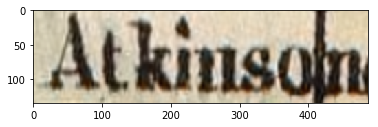

the matched words are (inorder): ['Atkinson']
ground truth: Atkinson
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


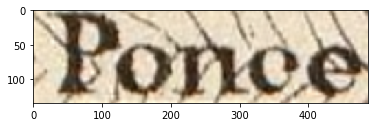

the matched words are (inorder): ['BISCAYNE']
ground truth: Ponce
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


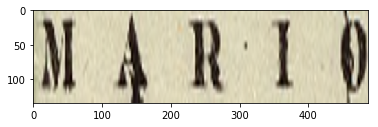

the matched words are (inorder): ['BRADFORD']
ground truth: MARIO
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


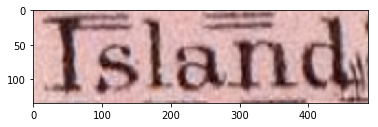

the matched words are (inorder): ['Island']
ground truth: Island
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


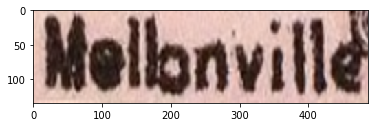

the matched words are (inorder): ['Mellonville']
ground truth: Mellonville
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


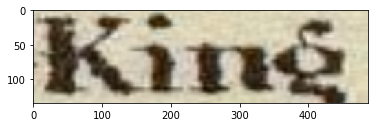

the matched words are (inorder): ['RIV']
ground truth: King
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


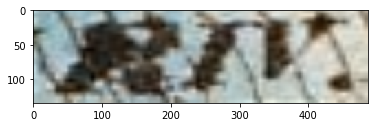

the matched words are (inorder): ['LIBERTY']
ground truth: RIV.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


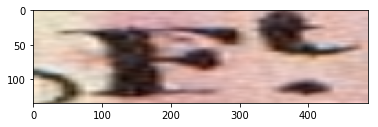

the matched words are (inorder): ['BIG']
ground truth: Ft.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


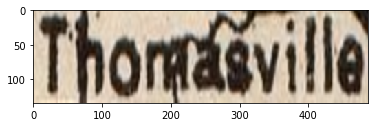

the matched words are (inorder): ['Thomasville']
ground truth: Thomasville
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


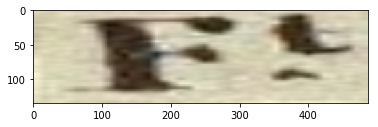

the matched words are (inorder): ['Ridge']
ground truth: Ft.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


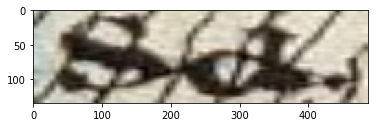

the matched words are (inorder): ['Carroll']
ground truth: Sd.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


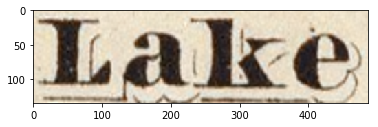

the matched words are (inorder): ['Lake']
ground truth: Lake
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


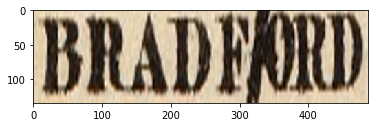

the matched words are (inorder): ['BRADFORD']
ground truth: BRADFORD
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


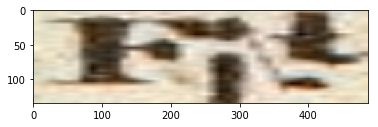

the matched words are (inorder): ['JEFFERSON']
ground truth: Ft.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


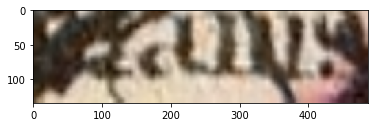

the matched words are (inorder): ['Grahams']
ground truth: unreadable
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


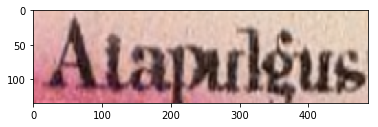

the matched words are (inorder): ['Atapulgus']
ground truth: Atapulgus
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


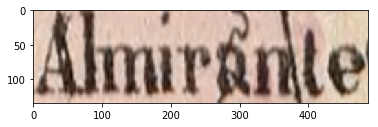

the matched words are (inorder): ['Almirante']
ground truth: Almirante
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


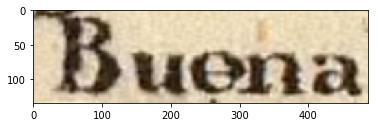

the matched words are (inorder): ['Buena']
ground truth: Buena
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


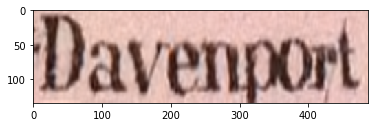

the matched words are (inorder): ['Davenport']
ground truth: Davenport
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


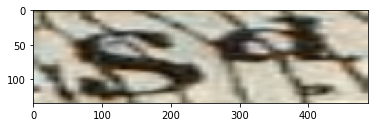

the matched words are (inorder): ['STRAIT']
ground truth: Sd.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


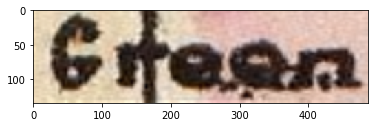

the matched words are (inorder): ['Buena']
ground truth: Green
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


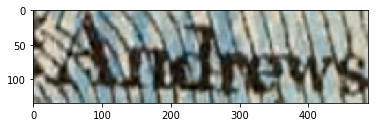

the matched words are (inorder): ['ANDREWS']
ground truth: Andrews
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


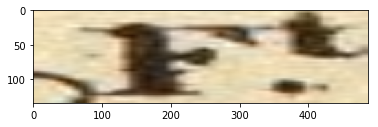

the matched words are (inorder): ['Bristol']
ground truth: Ft.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


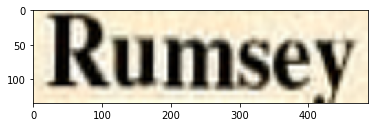

the matched words are (inorder): ['Rumsey']
ground truth: Rumsey
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


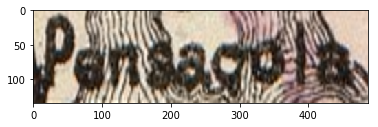

the matched words are (inorder): ['APPALACHEE']
ground truth: Pensacola
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


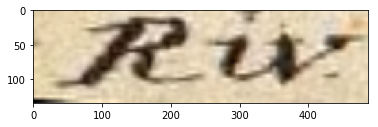

the matched words are (inorder): ['IN.']
ground truth: Riv.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


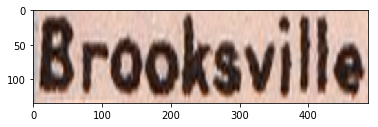

the matched words are (inorder): ['Brooksville']
ground truth: Brooksville
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


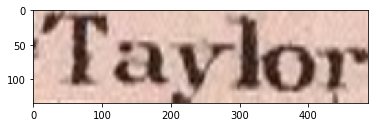

the matched words are (inorder): ['Taylor']
ground truth: Taylor
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


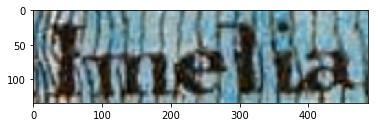

the matched words are (inorder): ['STRAIT']
ground truth: Imelia
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


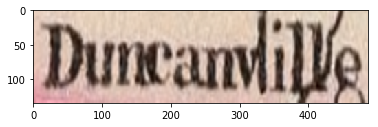

the matched words are (inorder): ['Duncanville']
ground truth: Duncanville
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


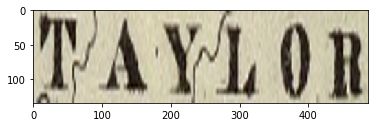

the matched words are (inorder): ['TAYLOR']
ground truth: TAYLOR
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


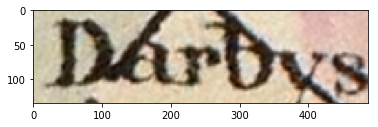

the matched words are (inorder): ['Marks']
ground truth: Darbys
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


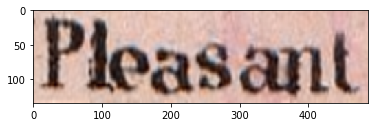

the matched words are (inorder): ['Pleasant']
ground truth: Pleasant
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


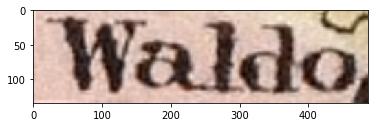

the matched words are (inorder): ['Waldo']
ground truth: Waldo
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


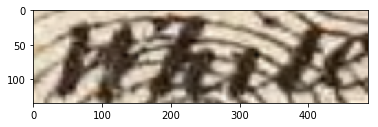

the matched words are (inorder): ['TALLAHASSEE']
ground truth: White
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


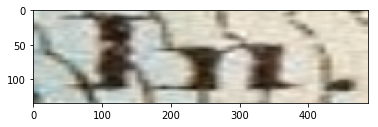

the matched words are (inorder): ['Still']
ground truth: In.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


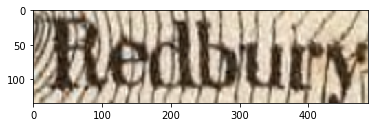

the matched words are (inorder): ['JOHNS']
ground truth: Redbury
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


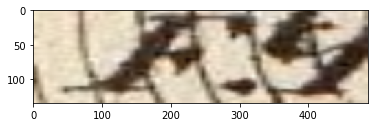

the matched words are (inorder): ['Olustee']
ground truth: Ft.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


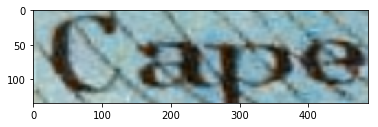

the matched words are (inorder): ['Cape']
ground truth: Cape
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


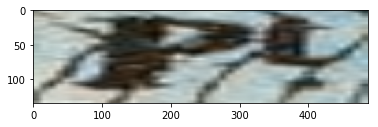

the matched words are (inorder): ['Sd.']
ground truth: Pt.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


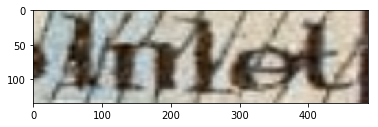

the matched words are (inorder): ['Inlet']
ground truth: Inlet
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


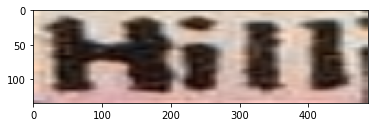

the matched words are (inorder): ['Pleasant']
ground truth: Hill
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


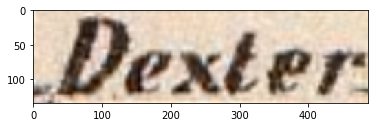

the matched words are (inorder): ['Dexter']
ground truth: Dexter
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


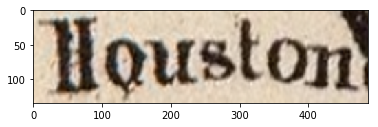

the matched words are (inorder): ['Houston']
ground truth: Houston
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


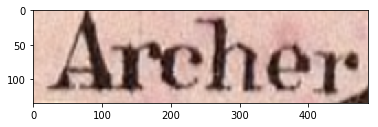

the matched words are (inorder): ['Archer']
ground truth: Archer
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


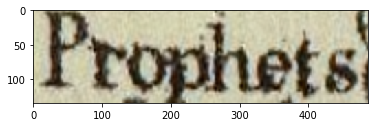

the matched words are (inorder): ['Prophets']
ground truth: Prophets
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


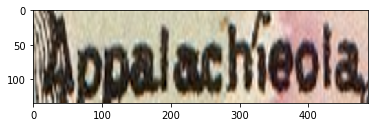

the matched words are (inorder): ['Appalachieola']
ground truth: Appalachieola
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


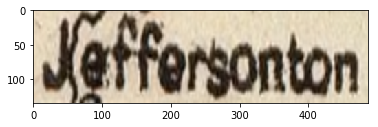

the matched words are (inorder): ['Jeffersonton']
ground truth: Jeffersonton
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


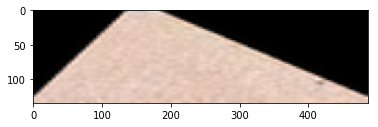

the matched words are (inorder): ['Augustine']
ground truth: Still
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


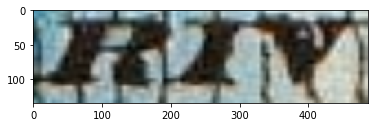

the matched words are (inorder): ['City']
ground truth: RIV
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


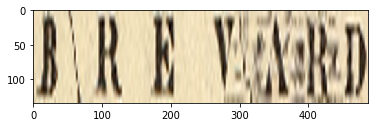

the matched words are (inorder): ['CLEARWATER']
ground truth: BREVARD
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


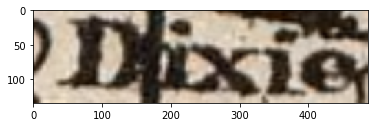

the matched words are (inorder): ['Dixie']
ground truth: Dixie
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


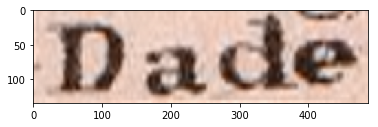

the matched words are (inorder): ['Dade']
ground truth: Dade
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


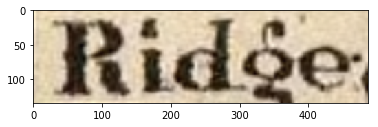

the matched words are (inorder): ['Ridge']
ground truth: Ridge
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


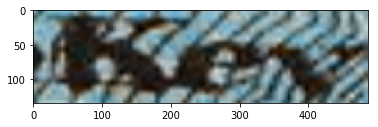

the matched words are (inorder): ['IIIs.']
ground truth: Key
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


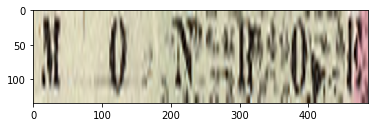

the matched words are (inorder): ['MONROE']
ground truth: MONROE
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


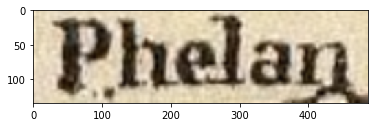

the matched words are (inorder): ['Phelan']
ground truth: Phelan
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


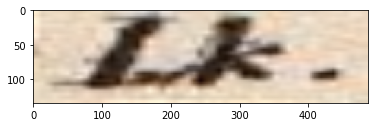

the matched words are (inorder): ['BAKER']
ground truth: Lk.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


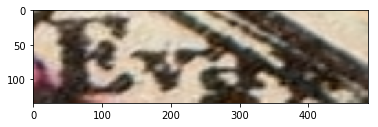

the matched words are (inorder): ['WEST']
ground truth: unreadable
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


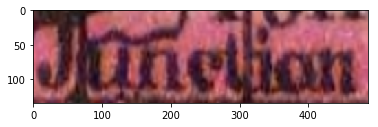

the matched words are (inorder): ['Johns']
ground truth: Junction
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


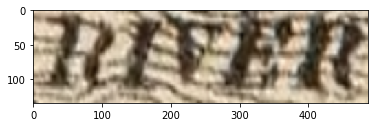

the matched words are (inorder): ['HOLMES']
ground truth: RIVER
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


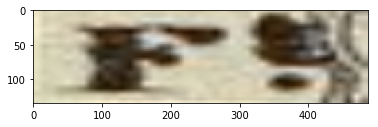

the matched words are (inorder): ['JEFFERSON']
ground truth: Ft.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


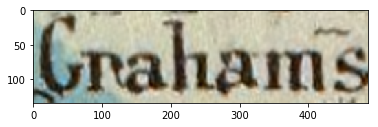

the matched words are (inorder): ['Grahams']
ground truth: Grahams
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


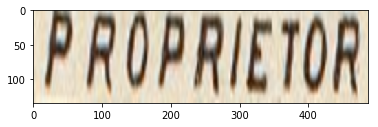

the matched words are (inorder): ['PROPRIETOR']
ground truth: PROPRIETOR
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


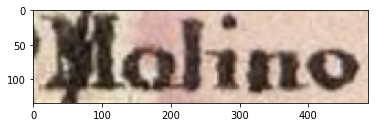

the matched words are (inorder): ['Molino']
ground truth: Molino
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


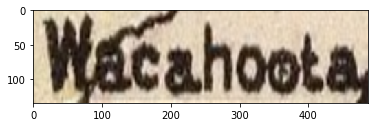

the matched words are (inorder): ['Wacahoota']
ground truth: Wacahoota
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


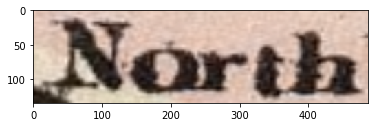

the matched words are (inorder): ['North']
ground truth: North
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


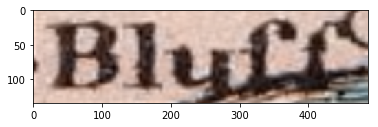

the matched words are (inorder): ['Bluff']
ground truth: Bluff
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


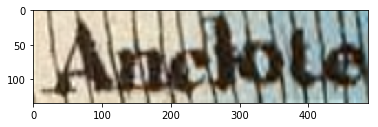

the matched words are (inorder): ['APPALACHEE']
ground truth: Anclote Keys
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


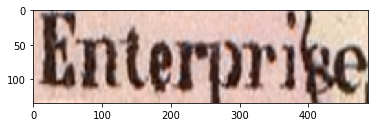

the matched words are (inorder): ['Enterprise']
ground truth: Enterprise
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


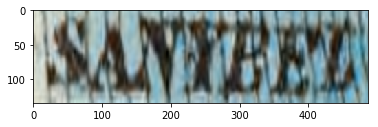

the matched words are (inorder): ['MARIA']
ground truth: SANYBEL
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


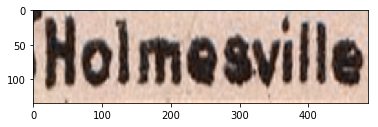

the matched words are (inorder): ['Holmesville']
ground truth: Holmesville
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


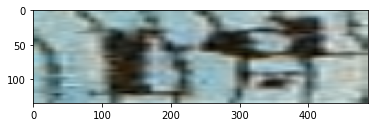

the matched words are (inorder): ['Gilberts']
ground truth: Id.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


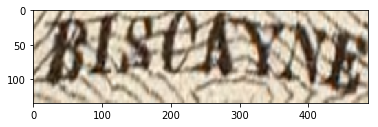

the matched words are (inorder): ['ISLANS']
ground truth: BISCAYNE
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


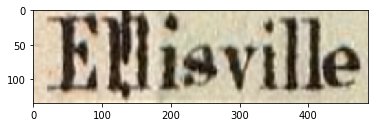

the matched words are (inorder): ['Ellisville']
ground truth: Ellisville
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


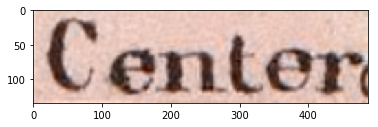

the matched words are (inorder): ['Center']
ground truth: Center
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


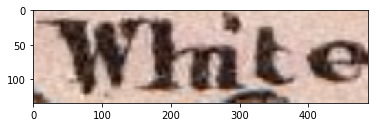

the matched words are (inorder): ['White']
ground truth: White
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


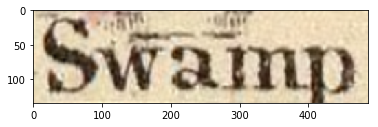

the matched words are (inorder): ['Swamp']
ground truth: Swamp
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


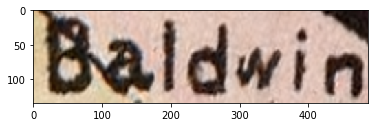

the matched words are (inorder): ['Baldwin']
ground truth: Baldwin
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


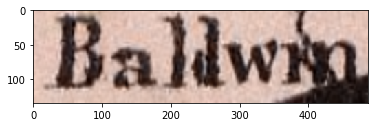

the matched words are (inorder): ['Baldwin']
ground truth: Baldwin
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


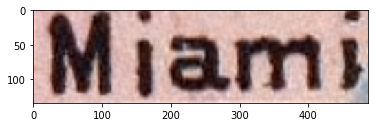

the matched words are (inorder): ['Miami']
ground truth: Miami
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


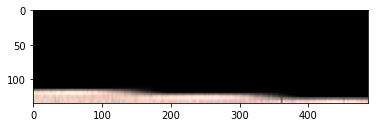

the matched words are (inorder): ['Buena']
ground truth: ORANGE
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


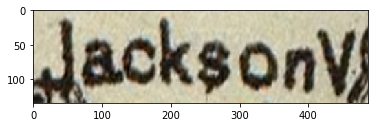

the matched words are (inorder): ['JacksonV']
ground truth: JacksonV
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


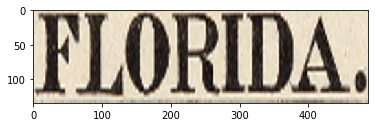

the matched words are (inorder): ['FLORIDA.']
ground truth: FLORIDA.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


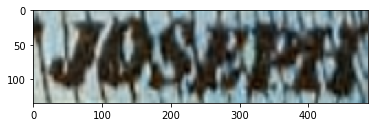

the matched words are (inorder): ['WESTERN']
ground truth: JOSEPH
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


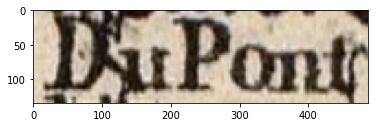

the matched words are (inorder): ['Davenport']
ground truth: delete
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


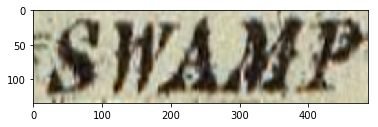

the matched words are (inorder): ['SWAMP']
ground truth: SWAMP
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


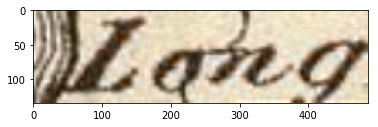

the matched words are (inorder): ['Bay']
ground truth: Long
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


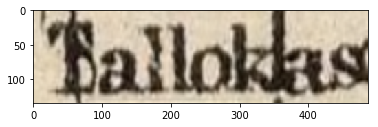

the matched words are (inorder): ['Tallokas']
ground truth: Tallokas
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


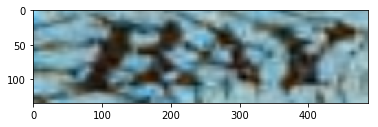

the matched words are (inorder): ['SANTAROSA']
ground truth: BAY
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


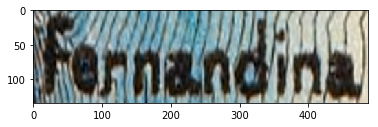

the matched words are (inorder): ['Vanswearingen']
ground truth: Fernandina
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


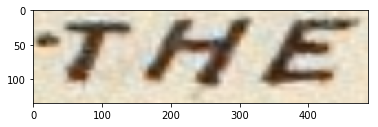

the matched words are (inorder): ['THE']
ground truth: THE
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


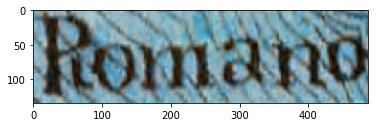

the matched words are (inorder): ['JOHNS']
ground truth: Romano
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


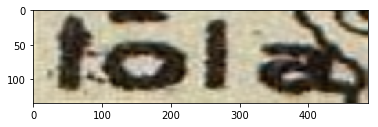

the matched words are (inorder): ['Bogias']
ground truth: unreadable
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


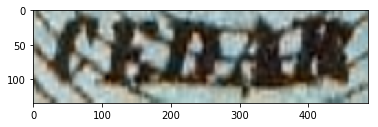

the matched words are (inorder): ['WESTERN']
ground truth: CEDAR
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


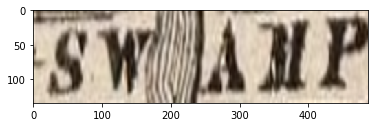

the matched words are (inorder): ['SWAMP']
ground truth: SWAMP
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


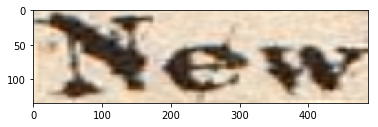

the matched words are (inorder): ['Myers']
ground truth: New
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


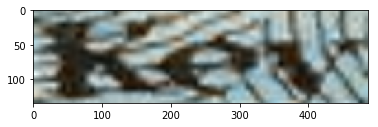

the matched words are (inorder): ['JEFFERSON']
ground truth: Key
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


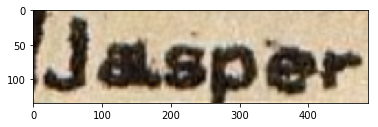

the matched words are (inorder): ['Jasper']
ground truth: Jasper
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


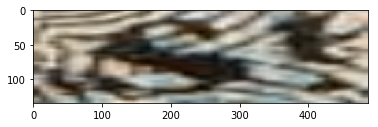

the matched words are (inorder): ['Dallas']
ground truth: St.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


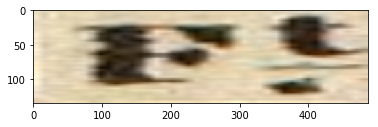

the matched words are (inorder): ['delete']
ground truth: Ft.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


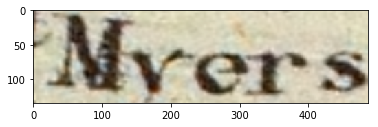

the matched words are (inorder): ['Bavards']
ground truth: Myers
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


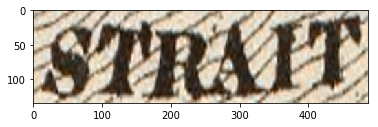

the matched words are (inorder): ['CUMBERLAND']
ground truth: STRAIT
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


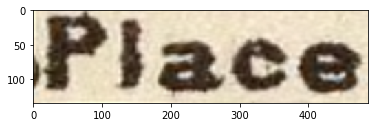

the matched words are (inorder): ['Place']
ground truth: Place
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


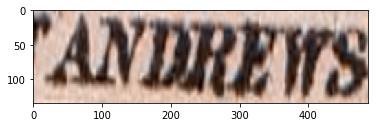

the matched words are (inorder): ['ANDREWS']
ground truth: ANDREWS
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


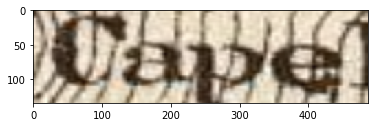

the matched words are (inorder): ['THE']
ground truth: Cape
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


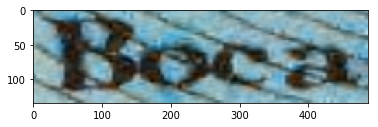

the matched words are (inorder): ['BISCAYNE']
ground truth: Boca
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


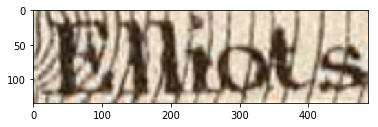

the matched words are (inorder): ['WAKUL']
ground truth: Elliots
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


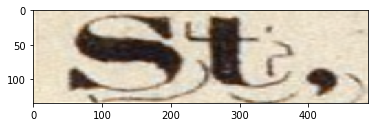

the matched words are (inorder): ['Austin']
ground truth: St,
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


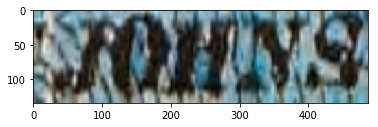

the matched words are (inorder): ['OYSTER']
ground truth: JOHNS
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


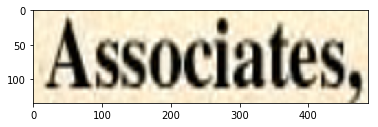

the matched words are (inorder): ['Associates,']
ground truth: Associates,
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


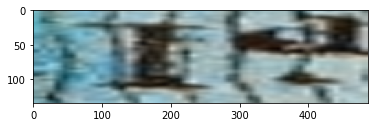

the matched words are (inorder): ['Jasper']
ground truth: Id.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


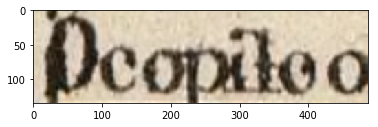

the matched words are (inorder): ['Molino']
ground truth: Ocopiloo
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


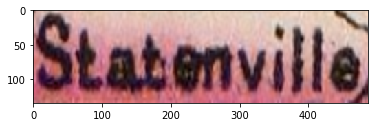

the matched words are (inorder): ['Statenville']
ground truth: Statenville
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


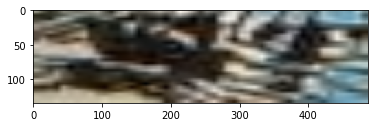

the matched words are (inorder): ['Passage']
ground truth: St.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


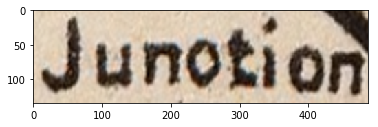

the matched words are (inorder): ['Junction']
ground truth: Junction
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


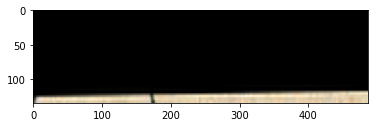

the matched words are (inorder): ['MERRITTS']
ground truth: Greenwood
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


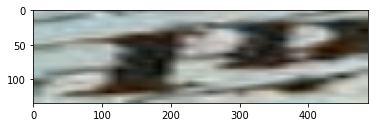

the matched words are (inorder): ['Sp.']
ground truth: Id.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


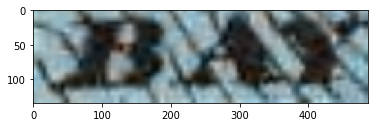

the matched words are (inorder): ['CYPRESS']
ground truth: BAY
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


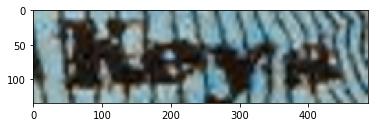

the matched words are (inorder): ['ERGLADES']
ground truth: Keys
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


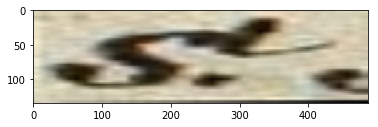

the matched words are (inorder): ['Vista']
ground truth: St.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


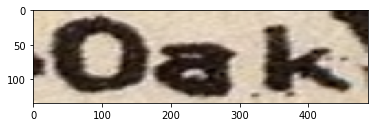

the matched words are (inorder): ['Oak']
ground truth: Oak
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


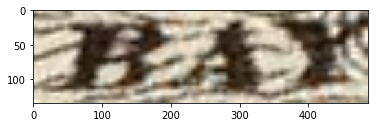

the matched words are (inorder): ['BAKER']
ground truth: BAY
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


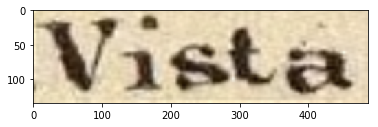

the matched words are (inorder): ['Vista']
ground truth: Vista
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


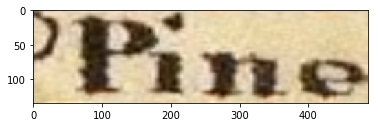

the matched words are (inorder): ['Pine']
ground truth: Pine
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


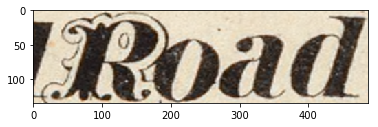

the matched words are (inorder): ['Rail']
ground truth: Road
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


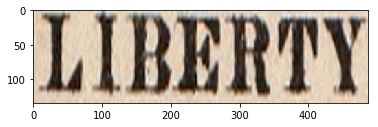

the matched words are (inorder): ['LIBERTY']
ground truth: LIBERTY
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


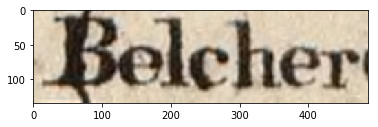

the matched words are (inorder): ['Belcher']
ground truth: Belcher
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


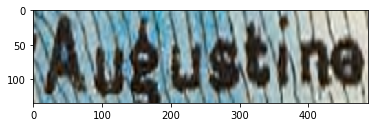

the matched words are (inorder): ['Austin']
ground truth: Augustine
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


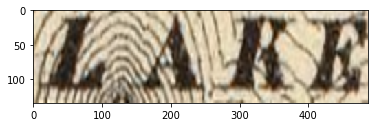

the matched words are (inorder): ['ANDREWS']
ground truth: LAKE
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


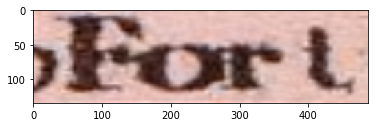

the matched words are (inorder): ['ROSA']
ground truth: Fort
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


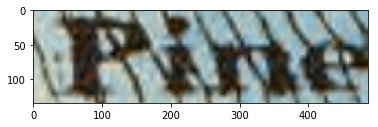

the matched words are (inorder): ['LIBERTY']
ground truth: Pine
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


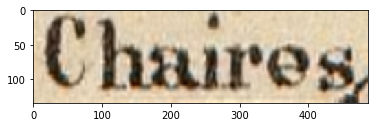

the matched words are (inorder): ['Chaires']
ground truth: Chaires
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


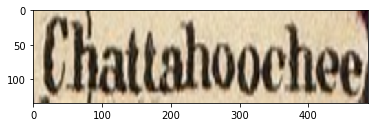

the matched words are (inorder): ['Chattahoochee']
ground truth: Chattahoochee
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


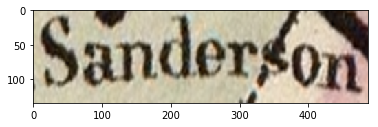

the matched words are (inorder): ['Sanderson']
ground truth: Sanderson
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


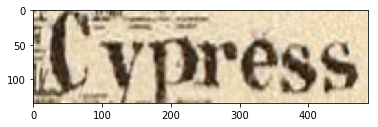

the matched words are (inorder): ['Cypress']
ground truth: Cypress
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


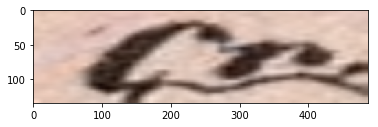

the matched words are (inorder): ['Elliots']
ground truth: Cr.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


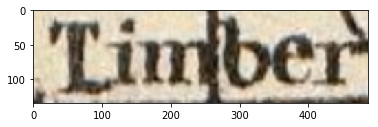

the matched words are (inorder): ['Timber']
ground truth: Timber
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


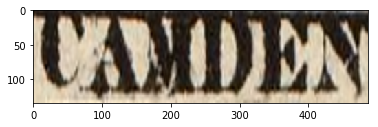

the matched words are (inorder): ['MADISON']
ground truth: CAMDEN
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


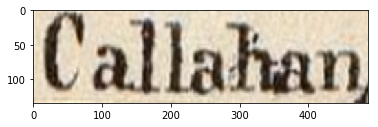

the matched words are (inorder): ['Callahan']
ground truth: Callahan
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


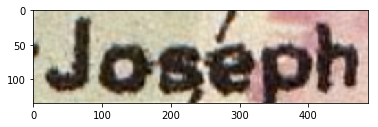

the matched words are (inorder): ['Joseph']
ground truth: Joseph
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


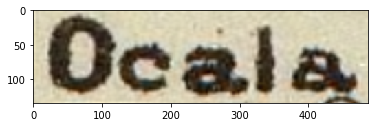

the matched words are (inorder): ['Ocala']
ground truth: Ocala
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


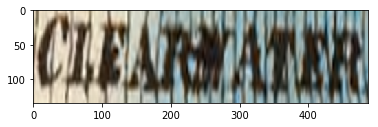

the matched words are (inorder): ['CHOCTAWHATCHEE']
ground truth: CLEARWATER
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


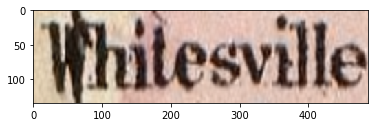

the matched words are (inorder): ['Whitesville']
ground truth: Whitesville
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


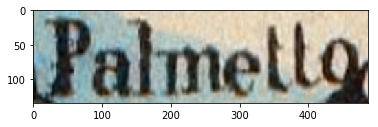

the matched words are (inorder): ['Palmetto']
ground truth: Palmetto
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


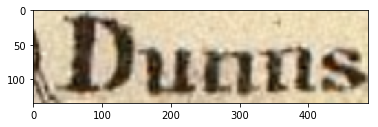

the matched words are (inorder): ['Dunns']
ground truth: Dunns
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


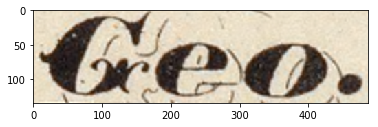

the matched words are (inorder): ['HERNANDO']
ground truth: Geo.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


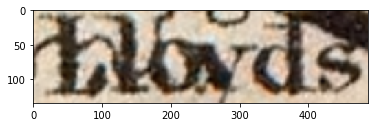

the matched words are (inorder): ['Lloyds']
ground truth: Lloyds
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


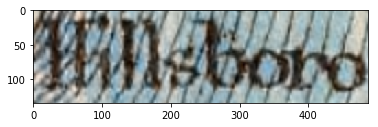

the matched words are (inorder): ['MARIA']
ground truth: HILLSBORO
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


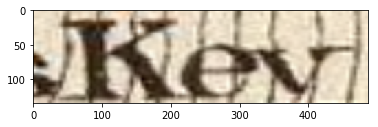

the matched words are (inorder): ['FRANKLIN']
ground truth: Key
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


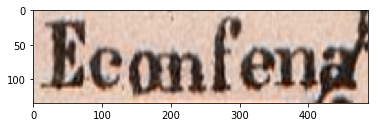

the matched words are (inorder): ['Econfena']
ground truth: Econfena
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


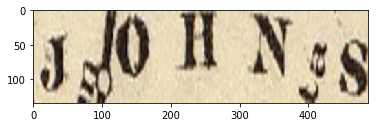

the matched words are (inorder): ['ISLANS']
ground truth: JOHNS
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


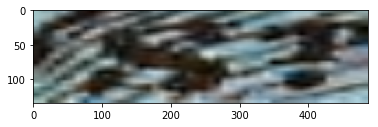

the matched words are (inorder): ['Inlet']
ground truth: St.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


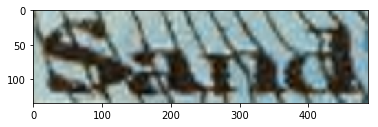

the matched words are (inorder): ['WASHINGTON']
ground truth: Sand
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


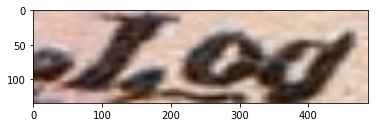

the matched words are (inorder): ['Mead']
ground truth: Log
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


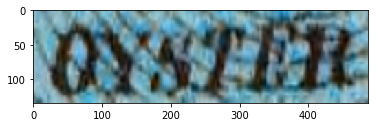

the matched words are (inorder): ['OYSTER']
ground truth: OYSTER
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


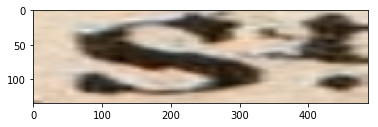

the matched words are (inorder): ['WEST']
ground truth: St.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


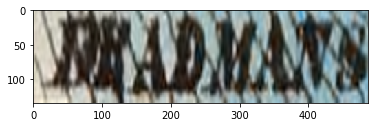

the matched words are (inorder): ['ANDREWS']
ground truth: DEADMANS
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


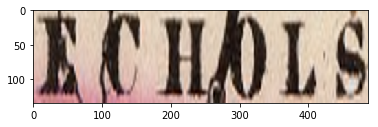

the matched words are (inorder): ['ECHOLS']
ground truth: ECHOLS
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


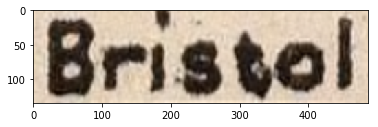

the matched words are (inorder): ['Bristol']
ground truth: Bristol
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


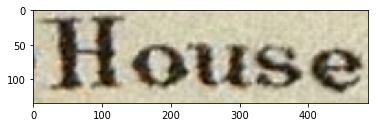

the matched words are (inorder): ['House']
ground truth: House
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


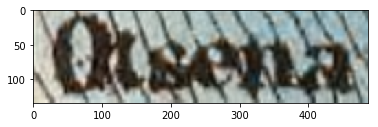

the matched words are (inorder): ['OYSTER']
ground truth: Olsena
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


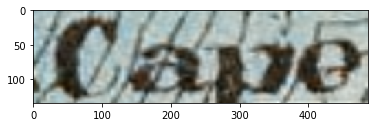

the matched words are (inorder): ['BAY']
ground truth: Cape
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


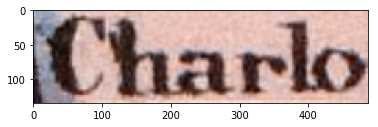

the matched words are (inorder): ['Charlo']
ground truth: Charlo
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


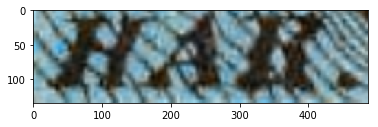

the matched words are (inorder): ['CYPRESS']
ground truth: HAR.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


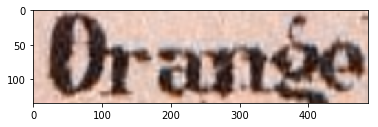

the matched words are (inorder): ['Orange']
ground truth: Orange
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


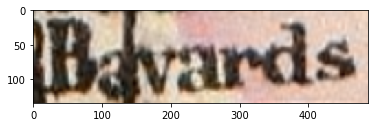

the matched words are (inorder): ['Bavards']
ground truth: Bavards
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


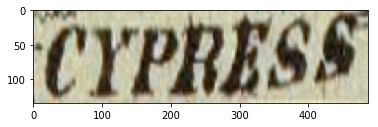

the matched words are (inorder): ['CYPRESS']
ground truth: CYPRESS
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


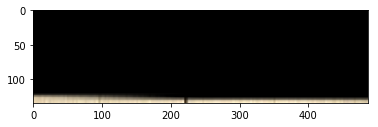

the matched words are (inorder): ['Buena']
ground truth: JACKSON
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


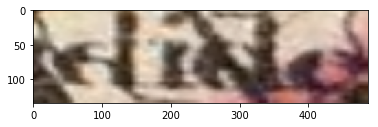

the matched words are (inorder): ['ISLANS']
ground truth: unreadable
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


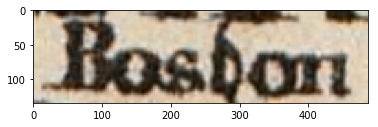

the matched words are (inorder): ['Bosbon']
ground truth: Bosbon
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


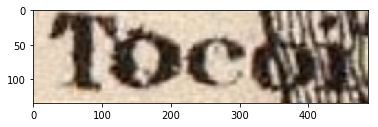

the matched words are (inorder): ['OYSTER']
ground truth: Tocoi
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


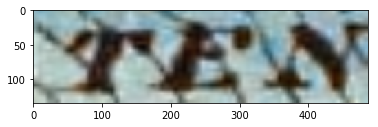

the matched words are (inorder): ['CYPRESS']
ground truth: TEN
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


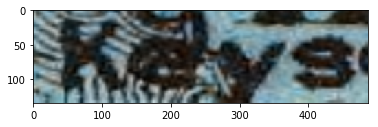

the matched words are (inorder): ['ISLANS']
ground truth: Keys
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


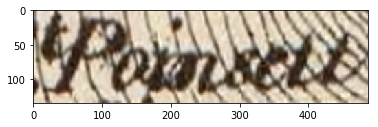

the matched words are (inorder): ['CYPRESS']
ground truth: Poinsett
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


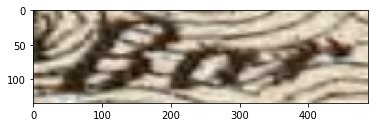

the matched words are (inorder): ['IIIs.']
ground truth: Bar
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


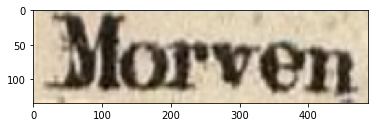

the matched words are (inorder): ['Morven']
ground truth: Morven
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


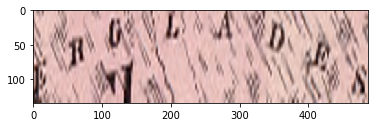

the matched words are (inorder): ['LOWNDS']
ground truth: ERGLADES
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


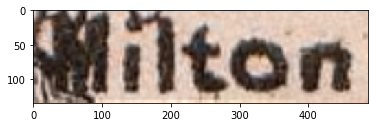

the matched words are (inorder): ['Winton']
ground truth: Milton
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


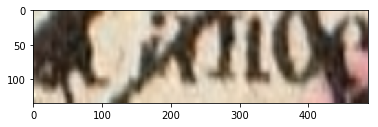

the matched words are (inorder): ['MADISON']
ground truth: unreadable
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


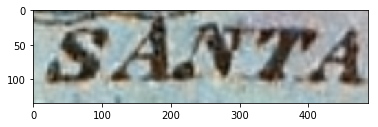

the matched words are (inorder): ['SANTA']
ground truth: SANTA
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


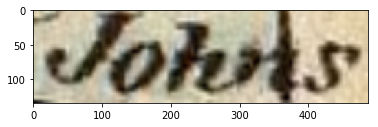

the matched words are (inorder): ['Olustee']
ground truth: Johns
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


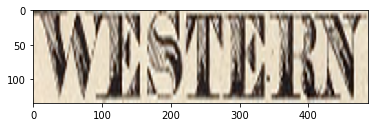

the matched words are (inorder): ['SUMTER']
ground truth: WESTERN
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


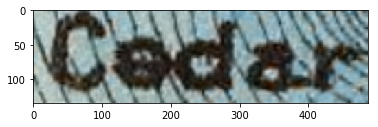

the matched words are (inorder): ['WESTERN']
ground truth: Cedar
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


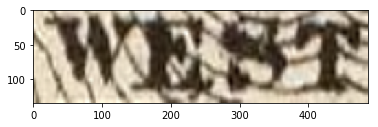

the matched words are (inorder): ['SDEN']
ground truth: WEST
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


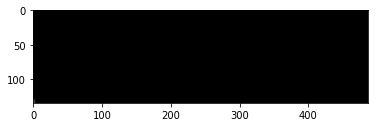

the matched words are (inorder): ['Road']
ground truth: CALHOUN
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


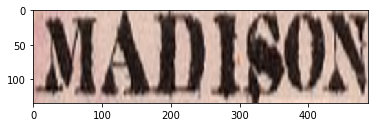

the matched words are (inorder): ['MADISON']
ground truth: MADISON
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


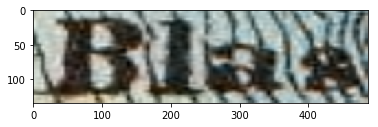

the matched words are (inorder): ['PUBLISHED']
ground truth: Blas
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


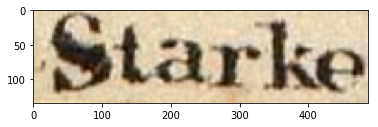

the matched words are (inorder): ['Stake']
ground truth: Stake
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


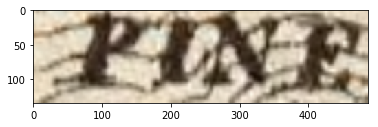

the matched words are (inorder): ['PINE']
ground truth: PINE
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


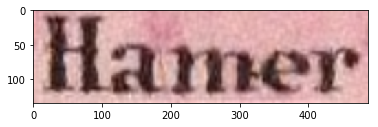

the matched words are (inorder): ['Hamer']
ground truth: Hamer
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


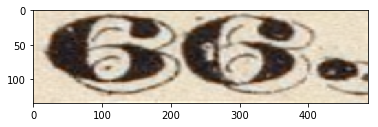

the matched words are (inorder): ['HILLSBORO']
ground truth: 66.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


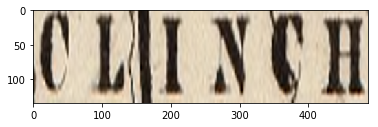

the matched words are (inorder): ['CLINCH']
ground truth: CLINCH
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


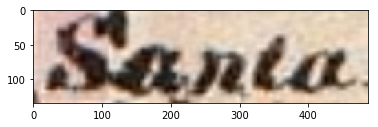

the matched words are (inorder): ['Santa']
ground truth: Santa
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


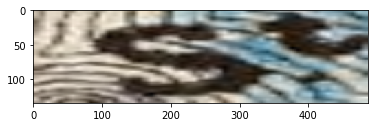

the matched words are (inorder): ['Vista']
ground truth: St.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


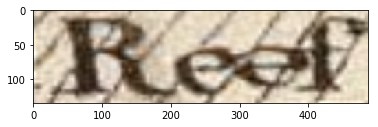

the matched words are (inorder): ['BIG']
ground truth: Reef
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


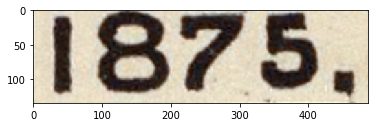

the matched words are (inorder): ['Gonzalia']
ground truth: 1875.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


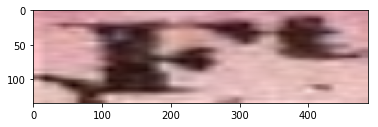

the matched words are (inorder): ['Vista']
ground truth: Ft.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


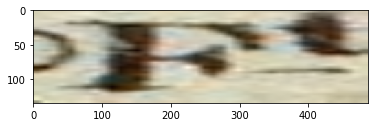

the matched words are (inorder): ['JOSEPH']
ground truth: Ft.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


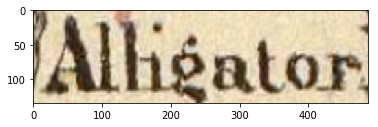

the matched words are (inorder): ['Alligator']
ground truth: Alligator
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


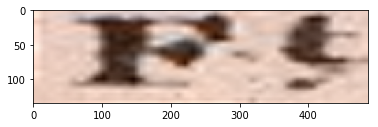

the matched words are (inorder): ['RIV']
ground truth: Ft.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


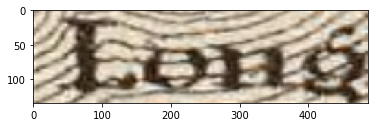

the matched words are (inorder): ['ERGLADES']
ground truth: Long
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


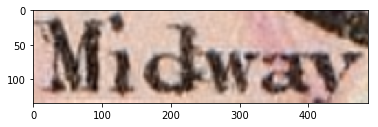

the matched words are (inorder): ['Midway']
ground truth: Midway
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


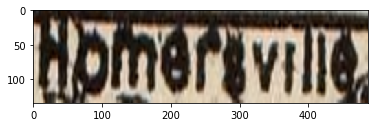

the matched words are (inorder): ['Augustine']
ground truth: Homersville
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


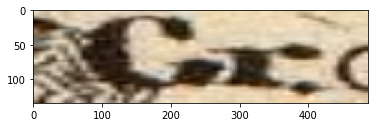

the matched words are (inorder): ['Spr.']
ground truth: Cr.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


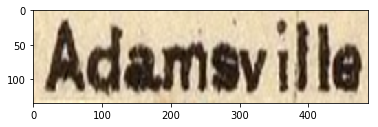

the matched words are (inorder): ['Adamsville']
ground truth: Adamsville
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


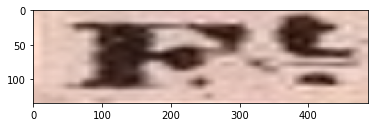

the matched words are (inorder): ['Log']
ground truth: Ft.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


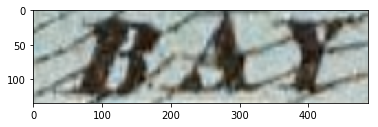

the matched words are (inorder): ['BRADFORD']
ground truth: BAY
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


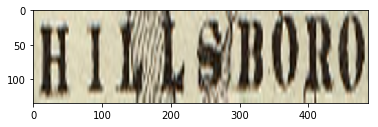

the matched words are (inorder): ['HILLSBORO']
ground truth: HILLSBORO
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


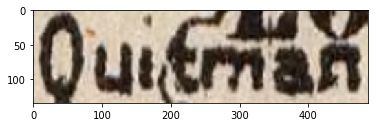

the matched words are (inorder): ['Quitman']
ground truth: Quitman
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


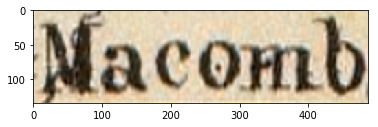

the matched words are (inorder): ['Macomb']
ground truth: Macomb
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


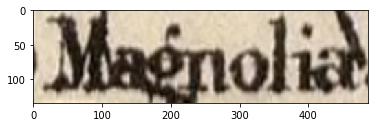

the matched words are (inorder): ['Magnolia']
ground truth: Magnolia
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


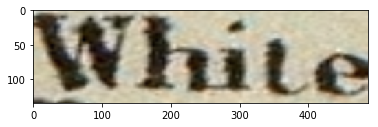

the matched words are (inorder): ['White']
ground truth: White
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


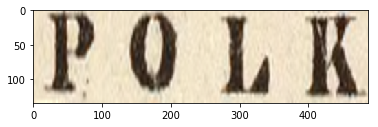

the matched words are (inorder): ['POLK']
ground truth: POLK
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


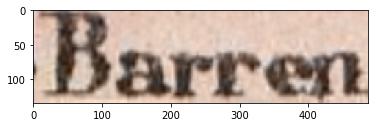

the matched words are (inorder): ['Barren']
ground truth: Barren
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


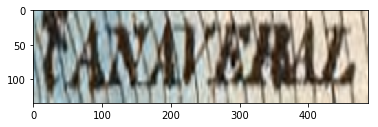

the matched words are (inorder): ['TAMPA']
ground truth: CANAVERAL
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


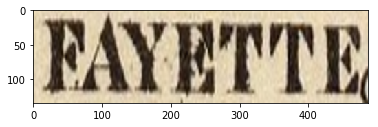

the matched words are (inorder): ['FAYETTE']
ground truth: FAYETTE
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


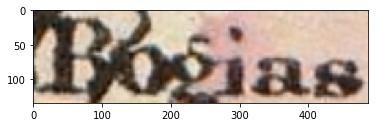

the matched words are (inorder): ['Bogias']
ground truth: Bogias
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


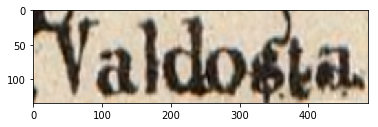

the matched words are (inorder): ['Valdosta']
ground truth: Valdosta
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


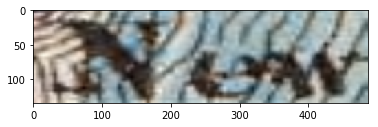

the matched words are (inorder): ['BIG']
ground truth: New
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


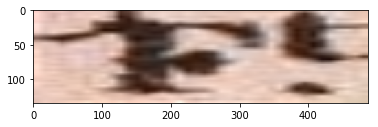

the matched words are (inorder): ['JOHNS']
ground truth: Ft.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


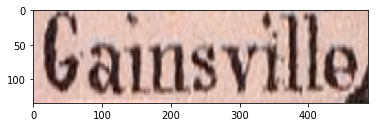

the matched words are (inorder): ['Gainsville']
ground truth: Gainsville
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


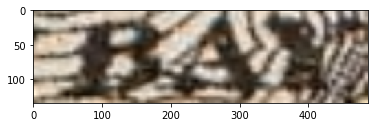

the matched words are (inorder): ['BAKER']
ground truth: BAY
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


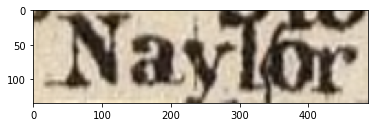

the matched words are (inorder): ['Naylor']
ground truth: Naylor
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


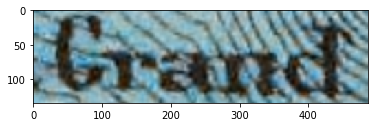

the matched words are (inorder): ['ISLANS']
ground truth: Grand
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


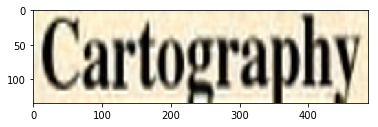

the matched words are (inorder): ['Cartography']
ground truth: Cartography
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


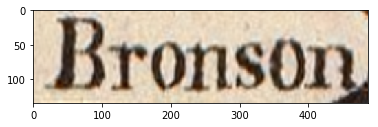

the matched words are (inorder): ['Bronson']
ground truth: Bronson
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


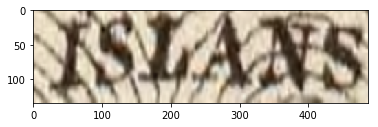

the matched words are (inorder): ['ERGLADES']
ground truth: ISLANS
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


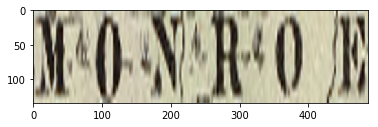

the matched words are (inorder): ['MONROE']
ground truth: MONROE
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


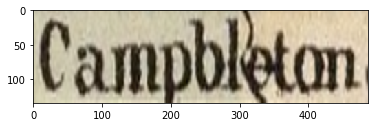

the matched words are (inorder): ['Campbleton']
ground truth: Campbleton
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


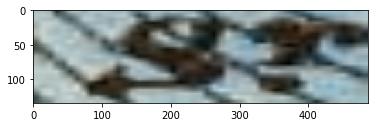

the matched words are (inorder): ['SUMTER']
ground truth: St.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


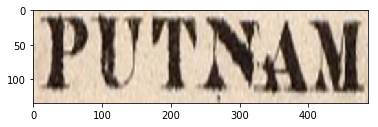

the matched words are (inorder): ['PUTNAM']
ground truth: PUTNAM
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


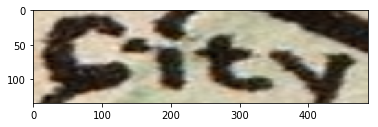

the matched words are (inorder): ['City']
ground truth: City
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


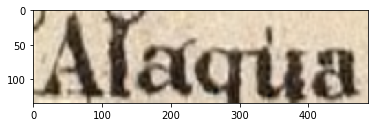

the matched words are (inorder): ['Land']
ground truth: Alaqua
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


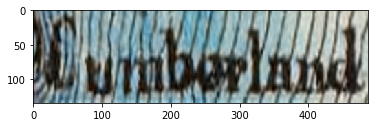

the matched words are (inorder): ['CUMBERLAND']
ground truth: Cumberland
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


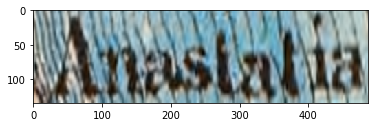

the matched words are (inorder): ['SUWANEE']
ground truth: Anastatia
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


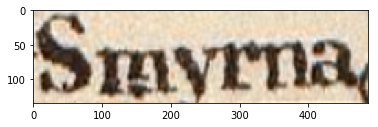

the matched words are (inorder): ['Smyrna']
ground truth: Smyrna
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


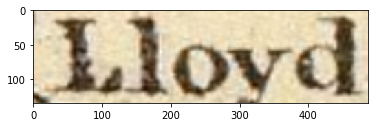

the matched words are (inorder): ['Lloyd']
ground truth: Lloyd
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


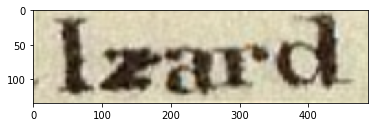

the matched words are (inorder): ['Ward']
ground truth: Izard
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


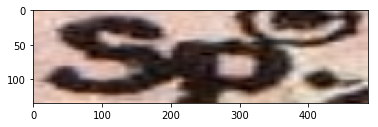

the matched words are (inorder): ['St.']
ground truth: Sp.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


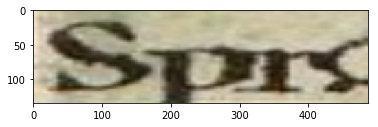

the matched words are (inorder): ['Spr.']
ground truth: Spr.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


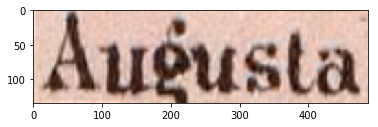

the matched words are (inorder): ['Augusta']
ground truth: Augusta
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


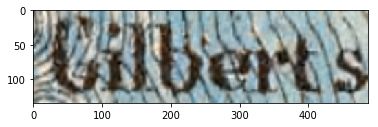

the matched words are (inorder): ['ISLANDS']
ground truth: Gilberts
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


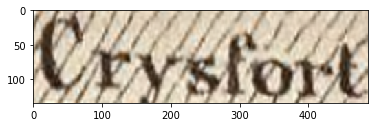

the matched words are (inorder): ['OYSTER']
ground truth: Crysfort
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


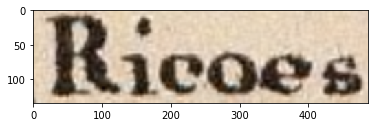

the matched words are (inorder): ['Ricoes']
ground truth: Ricoes
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


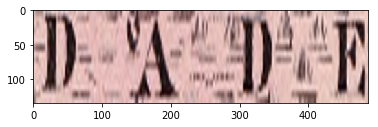

the matched words are (inorder): ['DADE']
ground truth: DADE
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


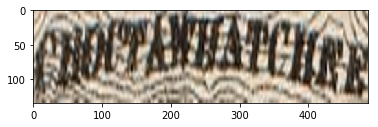

the matched words are (inorder): ['FAYETTE']
ground truth: CHOCTAWHATCHEE
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


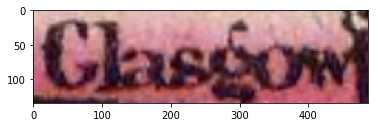

the matched words are (inorder): ['Grahams']
ground truth: Glasgow
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


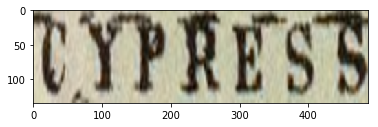

the matched words are (inorder): ['CYPRESS']
ground truth: CYPRESS
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


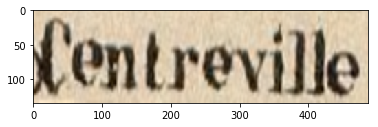

the matched words are (inorder): ['Centreville']
ground truth: Centreville
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


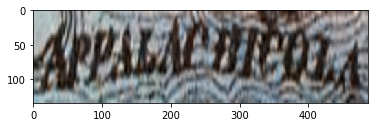

the matched words are (inorder): ['PINE']
ground truth: APPALACHICOLA
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


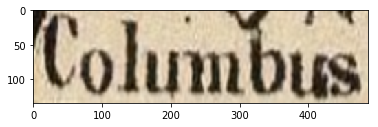

the matched words are (inorder): ['Columbus']
ground truth: Columbus
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


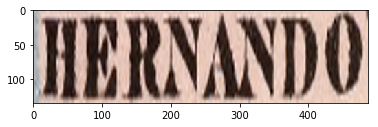

the matched words are (inorder): ['HERNANDO']
ground truth: HERNANDO
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


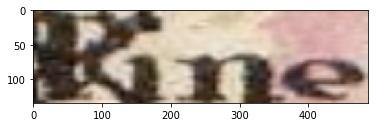

the matched words are (inorder): ['Grange']
ground truth: Kine
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


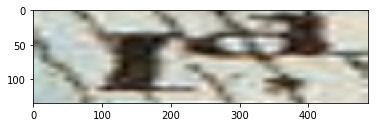

the matched words are (inorder): ['Poinsett']
ground truth: Id.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


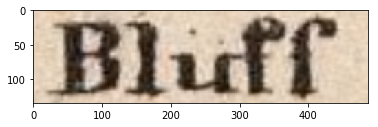

the matched words are (inorder): ['Bluff']
ground truth: Bluff
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


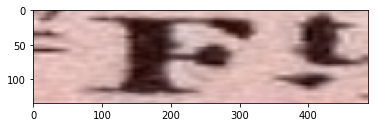

the matched words are (inorder): ['WEST']
ground truth: Ft.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


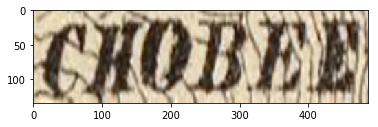

the matched words are (inorder): ['BAKER']
ground truth: CHOBEE
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


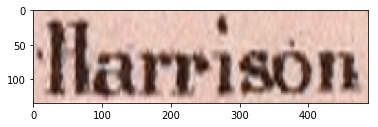

the matched words are (inorder): ['Harrison']
ground truth: Harrison
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


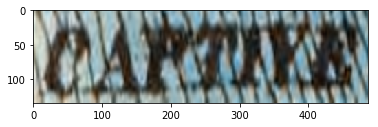

the matched words are (inorder): ['MARIO']
ground truth: CAPTIVE
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


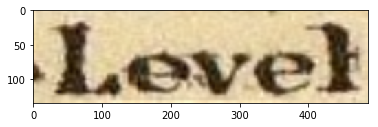

the matched words are (inorder): ['Morven']
ground truth: Level
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


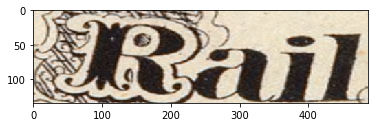

the matched words are (inorder): ['Rail']
ground truth: Rail
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


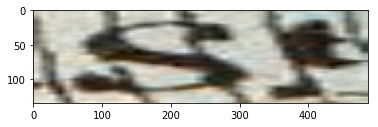

the matched words are (inorder): ['Sp.']
ground truth: St.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


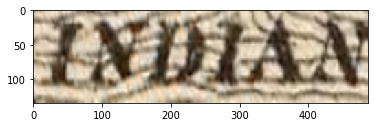

the matched words are (inorder): ['ERGLADES']
ground truth: INDIAN
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


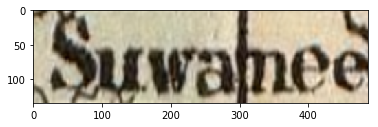

the matched words are (inorder): ['Suwanee']
ground truth: Suwanee
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


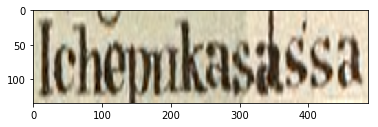

the matched words are (inorder): ['Imelia']
ground truth: Ichepukasassa
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


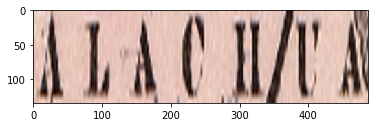

the matched words are (inorder): ['MARIA']
ground truth: ALACHUA
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


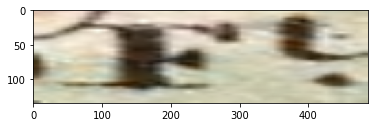

the matched words are (inorder): ['Ridge']
ground truth: Ft.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


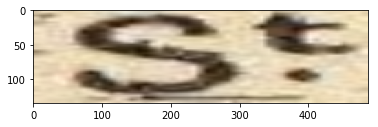

the matched words are (inorder): ["CRAM'S"]
ground truth: St.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


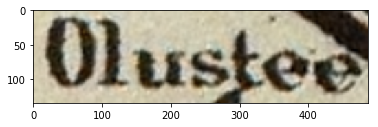

the matched words are (inorder): ['Olustee']
ground truth: Olustee
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


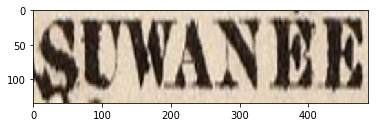

the matched words are (inorder): ['SUWANEE']
ground truth: SUWANEE
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


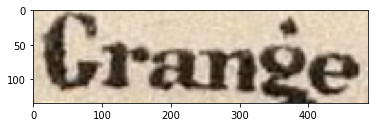

the matched words are (inorder): ['Grange']
ground truth: Grange
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


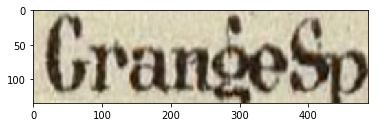

the matched words are (inorder): ['Chaires']
ground truth: GrangeSp
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


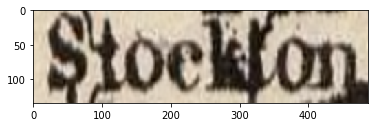

the matched words are (inorder): ['JACKSON']
ground truth: Stockton
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


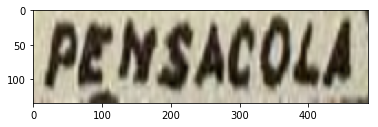

the matched words are (inorder): ['PENSACOLA']
ground truth: PENSACOLA
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


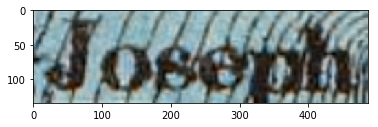

the matched words are (inorder): ['JOSEPH']
ground truth: Joseph
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


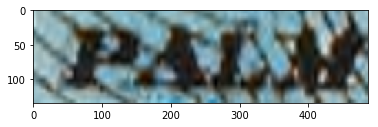

the matched words are (inorder): ['SANTAROSA']
ground truth: Palm
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


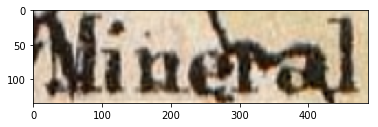

the matched words are (inorder): ['Mineral']
ground truth: Mineral
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


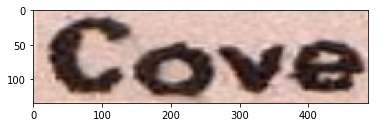

the matched words are (inorder): ['Cove']
ground truth: Cove
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


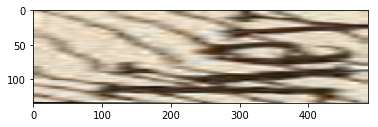

the matched words are (inorder): ['SD.']
ground truth: Key
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


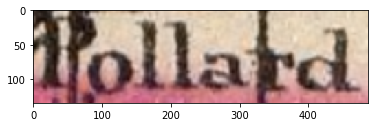

the matched words are (inorder): ['Pollard']
ground truth: Pollard
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


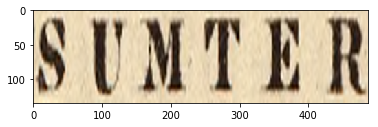

the matched words are (inorder): ['SUMTER']
ground truth: SUMTER
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


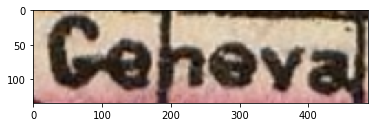

the matched words are (inorder): ['Caseys']
ground truth: Geneva
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


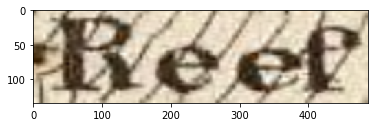

the matched words are (inorder): ['BAKER']
ground truth: Reef
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


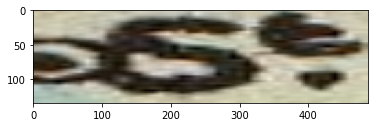

the matched words are (inorder): ['Vista']
ground truth: St.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


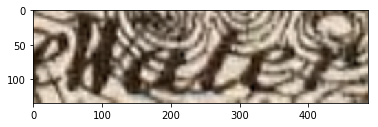

the matched words are (inorder): ['IN.']
ground truth: Water
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


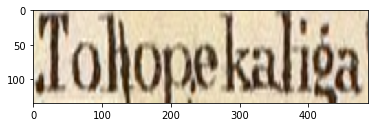

the matched words are (inorder): ['Tohopekaliga']
ground truth: Tohopekaliga
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


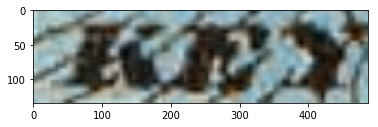

the matched words are (inorder): ['HERNANDO']
ground truth: KEY
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


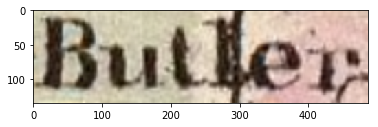

the matched words are (inorder): ['Butler']
ground truth: Butler
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


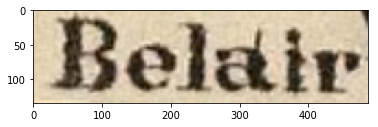

the matched words are (inorder): ['Belair']
ground truth: Belair
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


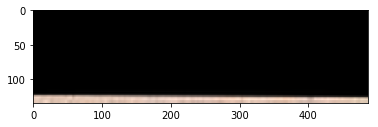

the matched words are (inorder): ['CLEARWATER']
ground truth: Vernon
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


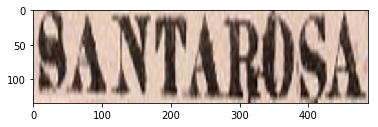

the matched words are (inorder): ['SANTAROSA']
ground truth: SANTAROSA
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


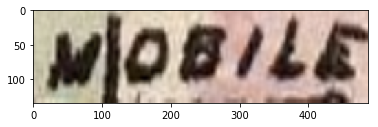

the matched words are (inorder): ['Myers']
ground truth: MOBILE
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


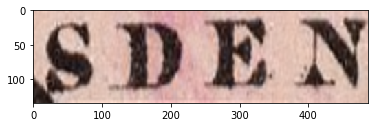

the matched words are (inorder): ['SDEN']
ground truth: SDEN
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


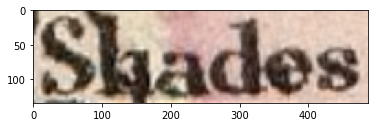

the matched words are (inorder): ['Shades']
ground truth: Shades
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


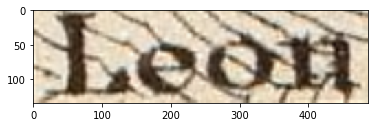

the matched words are (inorder): ['OYSTER']
ground truth: Leon
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


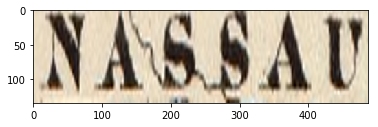

the matched words are (inorder): ['NASSAU']
ground truth: NASSAU
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


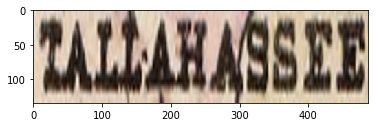

the matched words are (inorder): ['TALLAHASSEE']
ground truth: TALLAHASSEE
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


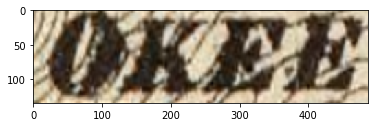

the matched words are (inorder): ['OYSTER']
ground truth: OKEE
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


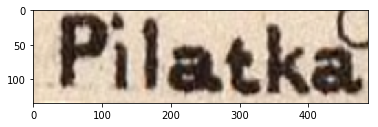

the matched words are (inorder): ['Pilatka']
ground truth: Pilatka
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


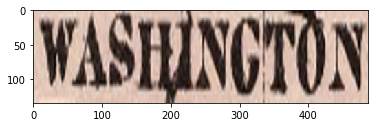

the matched words are (inorder): ['WASHINGTON']
ground truth: WASHINGTON
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


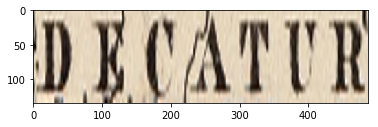

the matched words are (inorder): ['DECATUR']
ground truth: DECATUR
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


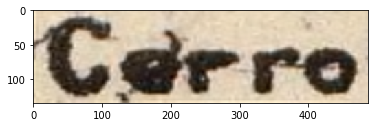

the matched words are (inorder): ['Cerro']
ground truth: Cerro
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


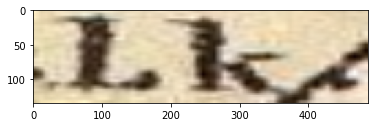

the matched words are (inorder): ['RIV.']
ground truth: Lk.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


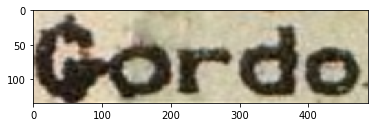

the matched words are (inorder): ['Gordo']
ground truth: Gordo
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


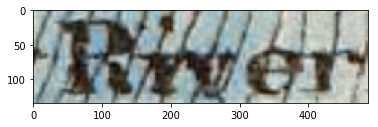

the matched words are (inorder): ['IN.']
ground truth: River
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


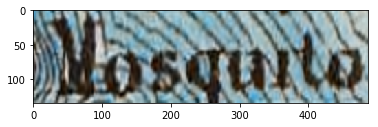

the matched words are (inorder): ['WESTERN']
ground truth: Mosquito
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


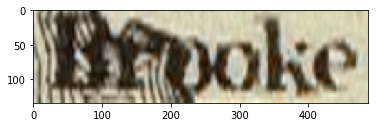

the matched words are (inorder): ['Ocopiloo']
ground truth: Brooke
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


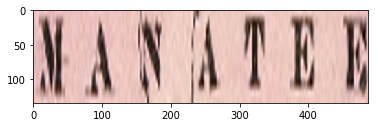

the matched words are (inorder): ['CAMDEN']
ground truth: MANATEE
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


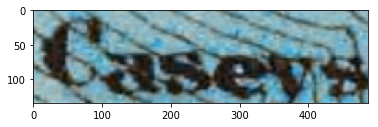

the matched words are (inorder): ['SDEN']
ground truth: Caseys
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


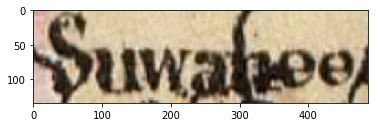

the matched words are (inorder): ['Suwanee']
ground truth: Suwanee
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


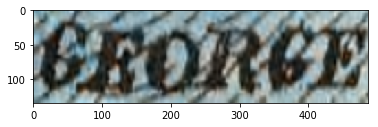

the matched words are (inorder): ['BROOKS']
ground truth: GEORGE
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


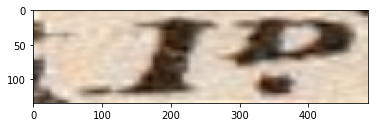

the matched words are (inorder): ['Atkinson']
ground truth: ID.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


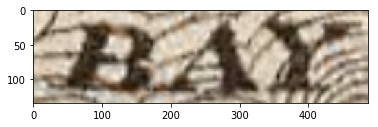

the matched words are (inorder): ['Vanswearingen']
ground truth: BAY
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


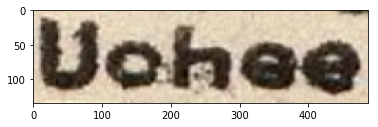

the matched words are (inorder): ['Uohee']
ground truth: Uohee
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


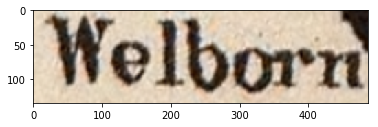

the matched words are (inorder): ['Welborn']
ground truth: Welborn
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


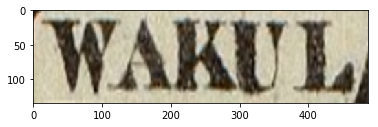

the matched words are (inorder): ['WAKUL']
ground truth: WAKUL
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


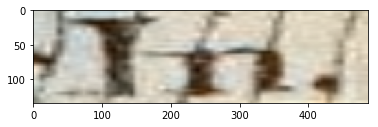

the matched words are (inorder): ['City']
ground truth: In.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


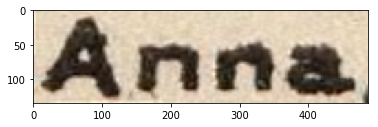

the matched words are (inorder): ['Anna']
ground truth: Anna
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


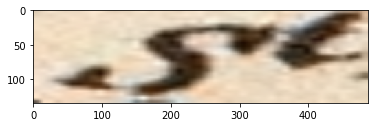

the matched words are (inorder): ['St.']
ground truth: St.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


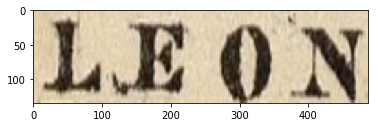

the matched words are (inorder): ['LEON']
ground truth: LEON
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


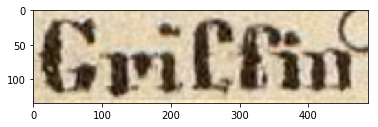

the matched words are (inorder): ['Lucie']
ground truth: Griffin
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


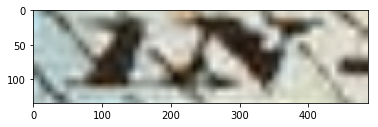

the matched words are (inorder): ['Ellisville']
ground truth: IN.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


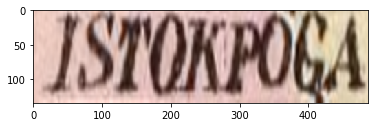

the matched words are (inorder): ['ISTOKPOGA']
ground truth: ISTOKPOGA
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


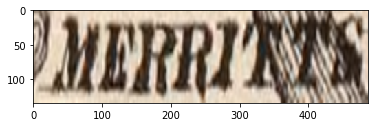

the matched words are (inorder): ['MARIA']
ground truth: MERRITTS
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


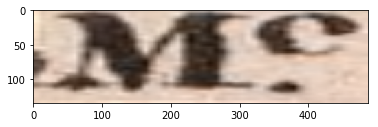

the matched words are (inorder): ['Mt.']
ground truth: Mc.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


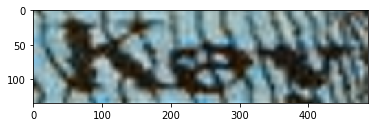

the matched words are (inorder): ['HAR.']
ground truth: Key
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


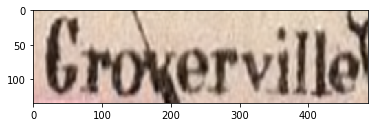

the matched words are (inorder): ['Groverville']
ground truth: Groverville
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


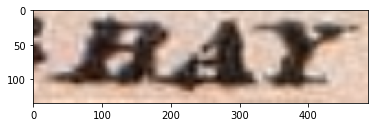

the matched words are (inorder): ['CLAY']
ground truth: BAY
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


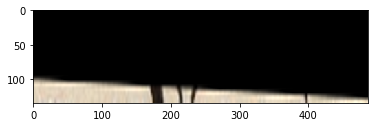

the matched words are (inorder): ['House']
ground truth: THOMAS
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


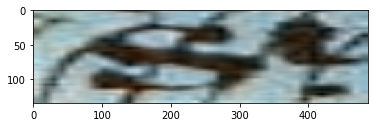

the matched words are (inorder): ['Cr.']
ground truth: St.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


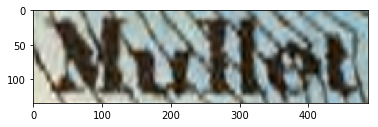

the matched words are (inorder): ['SUWANEE']
ground truth: Mullet
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


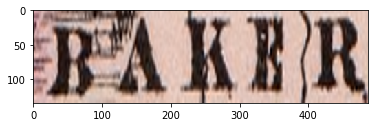

the matched words are (inorder): ['BAKER']
ground truth: BAKER
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


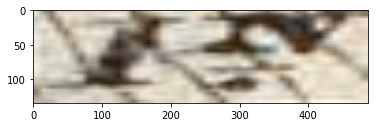

the matched words are (inorder): ['SD.']
ground truth: IN.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


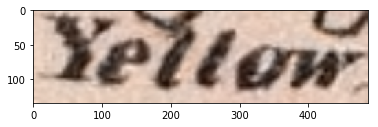

the matched words are (inorder): ['Yellow']
ground truth: Yellow
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


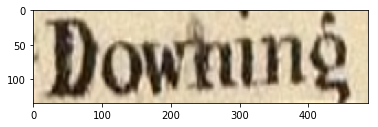

the matched words are (inorder): ['Downing']
ground truth: Downing
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


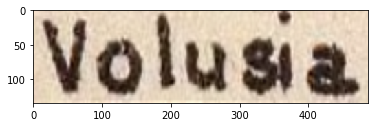

the matched words are (inorder): ['Volusia']
ground truth: Volusia
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


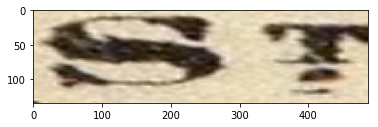

the matched words are (inorder): ['Augusta']
ground truth: St.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


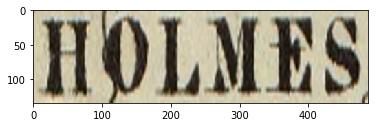

the matched words are (inorder): ['HOLMES']
ground truth: HOLMES
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


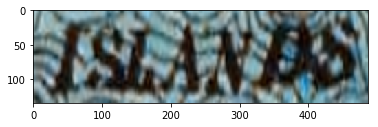

the matched words are (inorder): ['ISLANS']
ground truth: ISLANDS
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


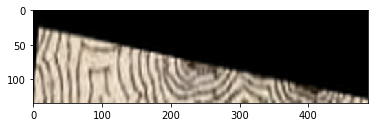

the matched words are (inorder): ['IN.']
ground truth: FLORIDA
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


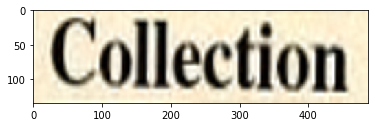

the matched words are (inorder): ['Collection']
ground truth: Collection
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


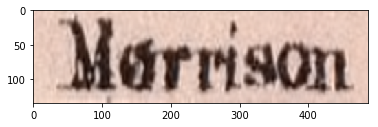

the matched words are (inorder): ['Morrison']
ground truth: Morrison
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


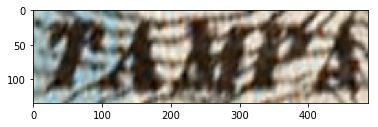

the matched words are (inorder): ['SUMTER']
ground truth: TAMPA
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


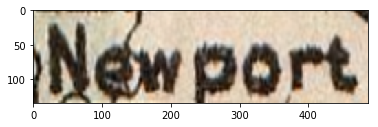

the matched words are (inorder): ['Newport']
ground truth: Newport
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


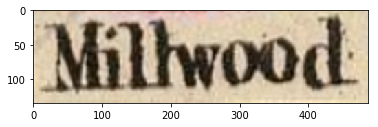

the matched words are (inorder): ['MONROE']
ground truth: Millwood
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


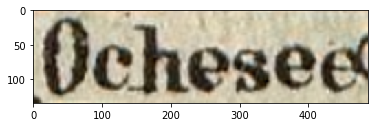

the matched words are (inorder): ['Ochesee']
ground truth: Ochesee
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


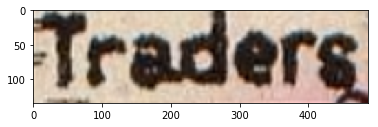

the matched words are (inorder): ['Traders']
ground truth: Traders
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


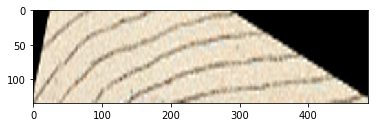

the matched words are (inorder): ['Chaires']
ground truth: FLORIDA
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


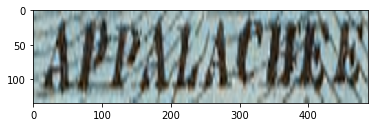

the matched words are (inorder): ['HAMILTON']
ground truth: APPALACHEE
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


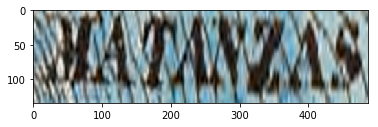

the matched words are (inorder): ['MONROE']
ground truth: MATANZAS
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


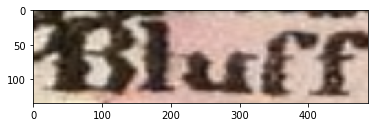

the matched words are (inorder): ['Bluff']
ground truth: Bluff
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


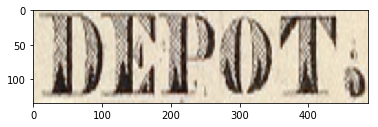

the matched words are (inorder): ['DADE']
ground truth: DEPOT.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


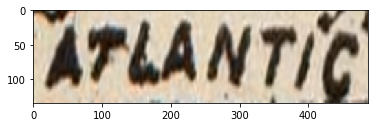

the matched words are (inorder): ['ATLANTIC']
ground truth: ATLANTIC
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


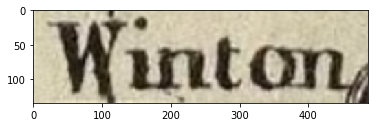

the matched words are (inorder): ['Winton']
ground truth: Winton
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


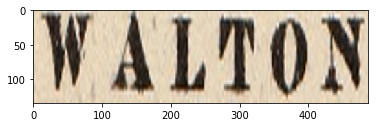

the matched words are (inorder): ['WALTON']
ground truth: WALTON
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


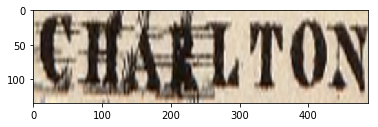

the matched words are (inorder): ['HAMILTON']
ground truth: CHARLTON
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


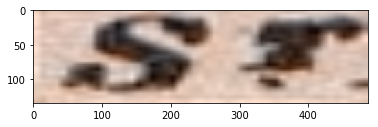

the matched words are (inorder): ['SD.']
ground truth: St.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


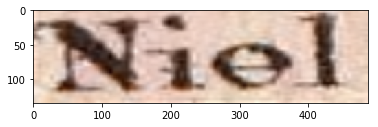

the matched words are (inorder): ['New']
ground truth: Niel
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


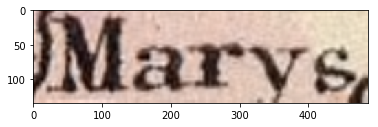

the matched words are (inorder): ['Marys']
ground truth: Marys
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


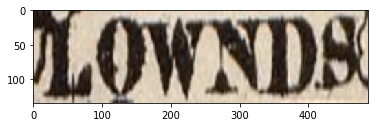

the matched words are (inorder): ['LOWNDS']
ground truth: LOWNDS
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


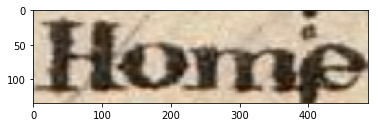

the matched words are (inorder): ['Home']
ground truth: Home
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


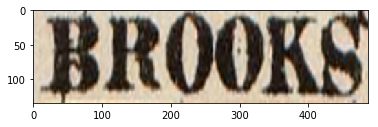

the matched words are (inorder): ['BROOKS']
ground truth: BROOKS
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


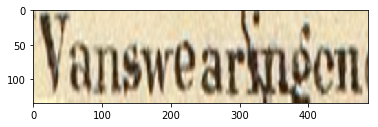

the matched words are (inorder): ['Vanswearingen']
ground truth: Vanswearingen
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


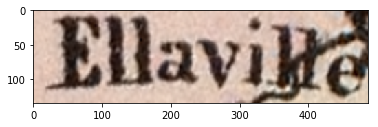

the matched words are (inorder): ['Ellaville']
ground truth: Ellaville
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


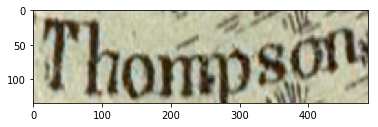

the matched words are (inorder): ['Thompson']
ground truth: Thompson
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


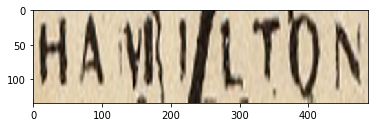

the matched words are (inorder): ['HAMILTON']
ground truth: HAMILTON
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


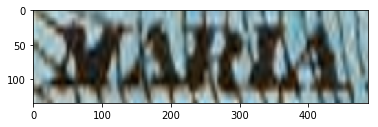

the matched words are (inorder): ['HOLMES']
ground truth: MARIA
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


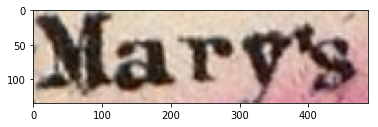

the matched words are (inorder): ["Mary's"]
ground truth: Mary's
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


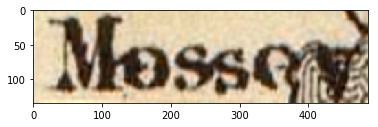

the matched words are (inorder): ['Mossey']
ground truth: Mossey
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


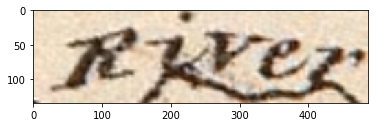

the matched words are (inorder): ['River']
ground truth: River
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


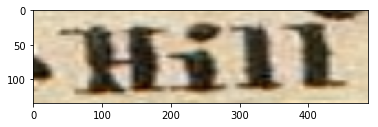

the matched words are (inorder): ['THE']
ground truth: Hill
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


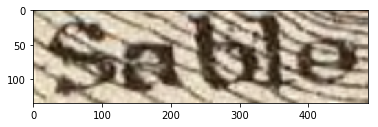

the matched words are (inorder): ['SANYBEL']
ground truth: Sable
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


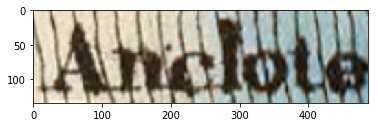

the matched words are (inorder): ['ALACHUA']
ground truth: Anclote
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


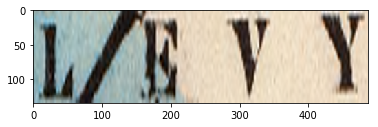

the matched words are (inorder): ['CLAY']
ground truth: LEVY
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


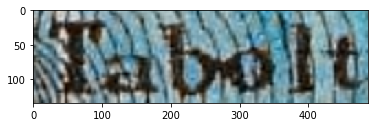

the matched words are (inorder): ['INDIAN']
ground truth: Tabolt
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


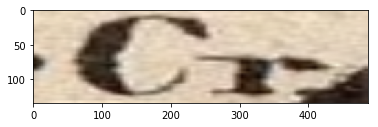

the matched words are (inorder): ['Harts']
ground truth: Cr.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


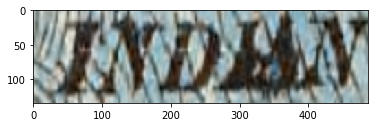

the matched words are (inorder): ['SUWANEE']
ground truth: INDIAN
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


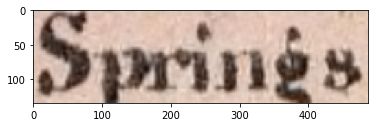

the matched words are (inorder): ['Still']
ground truth: Springs
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


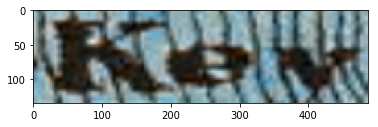

the matched words are (inorder): ['BREVARD']
ground truth: Key
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


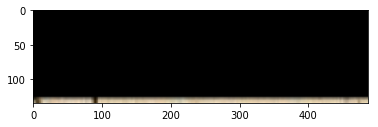

the matched words are (inorder): ['Vanswearingen']
ground truth: Marianna
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


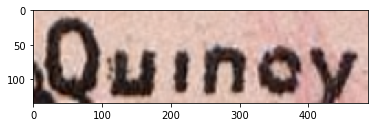

the matched words are (inorder): ['Quincy']
ground truth: Quincy
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


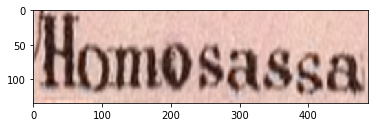

the matched words are (inorder): ['Homosassa']
ground truth: Homosassa
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


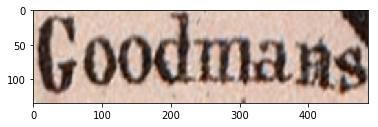

the matched words are (inorder): ['Goodmans']
ground truth: Goodmans
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


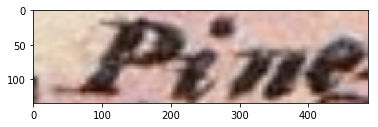

the matched words are (inorder): ['Dixie']
ground truth: Pine
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


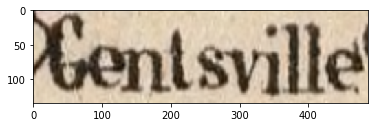

the matched words are (inorder): ['Gentsville']
ground truth: Gentsville
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


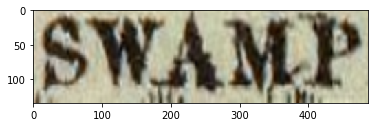

the matched words are (inorder): ['SWAMP']
ground truth: SWAMP
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


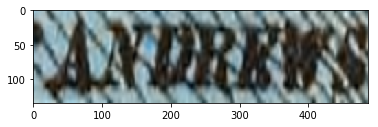

the matched words are (inorder): ['ANDREWS']
ground truth: ANDREWS
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


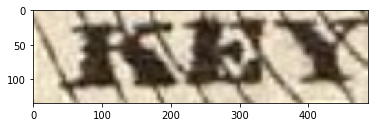

the matched words are (inorder): ['ISLANS']
ground truth: KEY
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


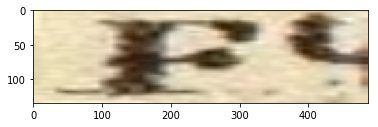

the matched words are (inorder): ['Ft.']
ground truth: Ft.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


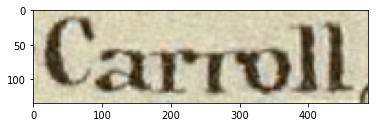

the matched words are (inorder): ['Carroll']
ground truth: Carroll
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


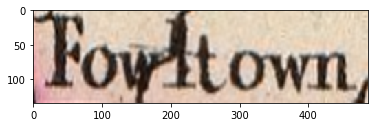

the matched words are (inorder): ['Fowltown']
ground truth: Fowltown
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


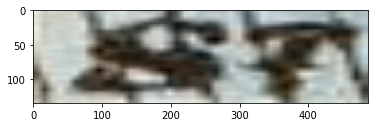

the matched words are (inorder): ['Fort']
ground truth: St.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


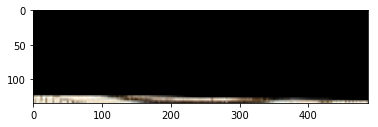

the matched words are (inorder): ['Buena']
ground truth: CRAM'S
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


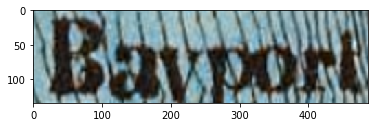

the matched words are (inorder): ['HILLSBORO']
ground truth: Bayport
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


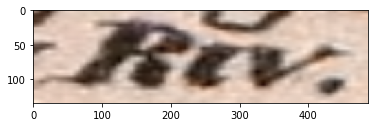

the matched words are (inorder): ['Caseys']
ground truth: Riv.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


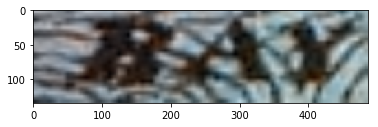

the matched words are (inorder): ['OYSTER']
ground truth: BAY
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


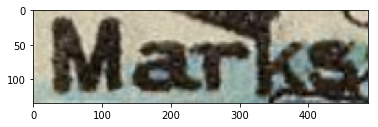

the matched words are (inorder): ['Marks']
ground truth: Marks
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


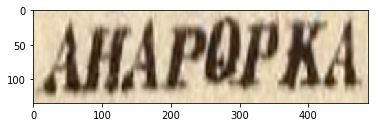

the matched words are (inorder): ['Apoka']
ground truth: AHAPOPKA
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


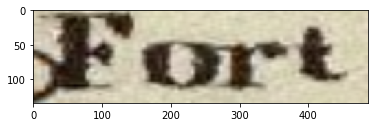

the matched words are (inorder): ['Fort']
ground truth: Fort
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


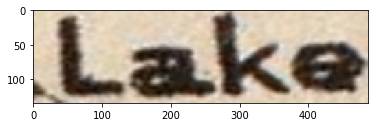

the matched words are (inorder): ['Lake']
ground truth: Lake
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


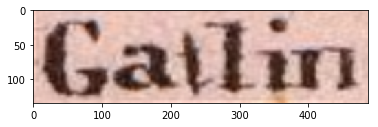

the matched words are (inorder): ['Gatlin']
ground truth: Gatlin
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


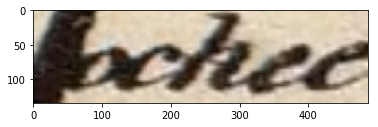

the matched words are (inorder): ['Sable']
ground truth: unreadable
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


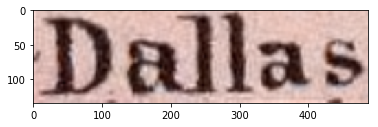

the matched words are (inorder): ['Dallas']
ground truth: Dallas
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


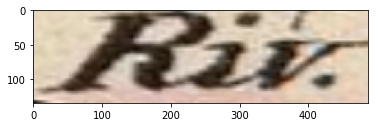

the matched words are (inorder): ['RIV']
ground truth: Riv.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


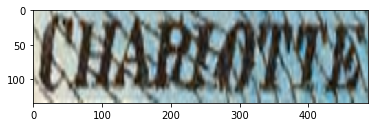

the matched words are (inorder): ['WASHINGTON']
ground truth: CHARLOTTE
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


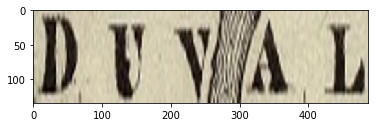

the matched words are (inorder): ['DUVAL']
ground truth: DUVAL
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


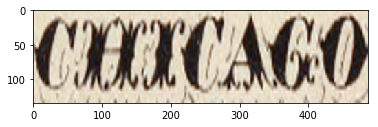

the matched words are (inorder): ['HERNANDO']
ground truth: CHICAGO
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


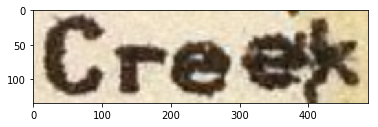

the matched words are (inorder): ['Creek']
ground truth: Creek
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


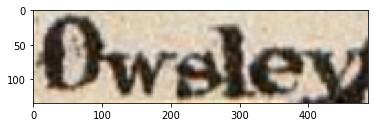

the matched words are (inorder): ['Owsley']
ground truth: Owsley
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


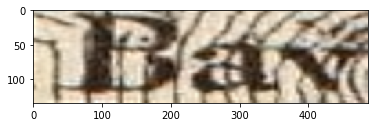

the matched words are (inorder): ['BAKER']
ground truth: Bay
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


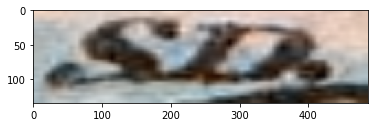

the matched words are (inorder): ['RIVER']
ground truth: SD.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


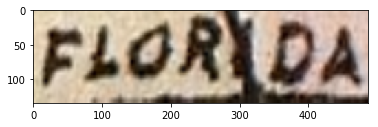

the matched words are (inorder): ['FLORIDA']
ground truth: FLORIDA
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


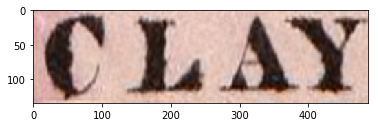

the matched words are (inorder): ['CLAY']
ground truth: CLAY
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


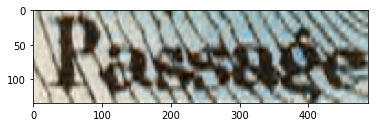

the matched words are (inorder): ['ANDREWS']
ground truth: Passage
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


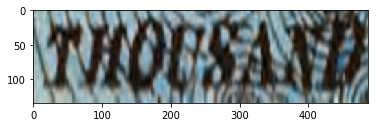

the matched words are (inorder): ['WESTERN']
ground truth: THOUSAND
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


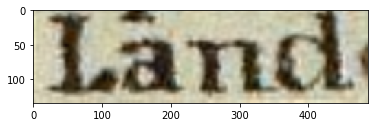

the matched words are (inorder): ['Grand']
ground truth: Land
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


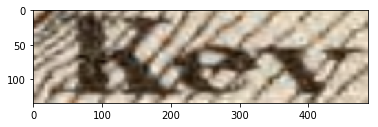

the matched words are (inorder): ['LIBERTY']
ground truth: Key
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


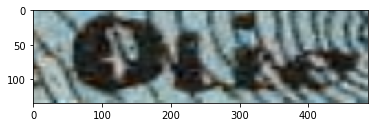

the matched words are (inorder): ['NASSAU']
ground truth: Olie
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


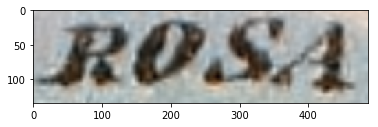

the matched words are (inorder): ['ROSA']
ground truth: ROSA
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


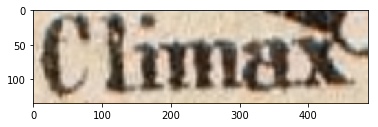

the matched words are (inorder): ['CAMDEN']
ground truth: Climax
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


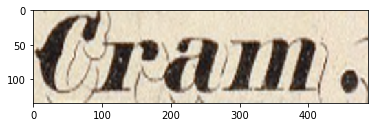

the matched words are (inorder): ['MARIA']
ground truth: Cram.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


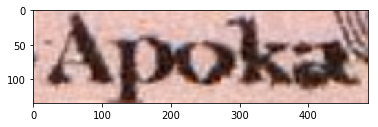

the matched words are (inorder): ['Lake']
ground truth: Apoka
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


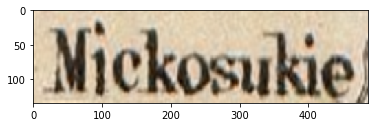

the matched words are (inorder): ['Mickosukie']
ground truth: Mickosukie
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


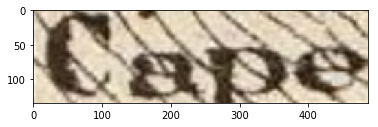

the matched words are (inorder): ['OYSTER']
ground truth: Cape
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


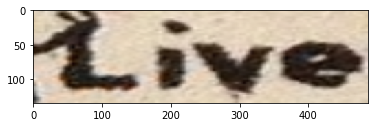

the matched words are (inorder): ['Live']
ground truth: Live
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


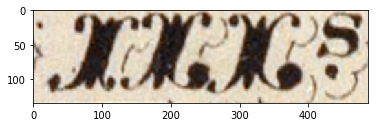

the matched words are (inorder): ['MERRITTS']
ground truth: IIIs.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


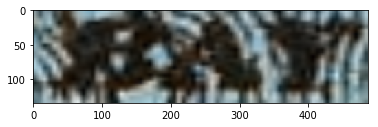

the matched words are (inorder): ['MARIA']
ground truth: BAY
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


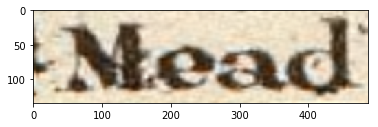

the matched words are (inorder): ['Mead']
ground truth: Mead
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


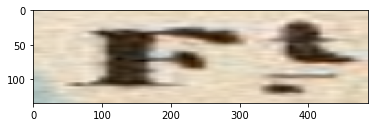

the matched words are (inorder): ['Fort']
ground truth: Ft.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


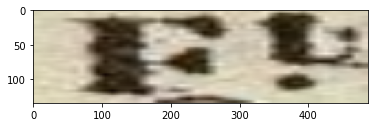

the matched words are (inorder): ['City']
ground truth: Ft.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


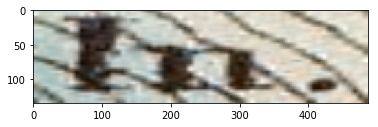

the matched words are (inorder): ['ISLANS']
ground truth: In.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


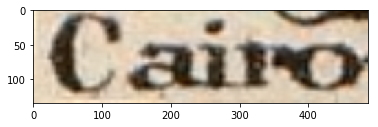

the matched words are (inorder): ['Cairo']
ground truth: Cairo
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


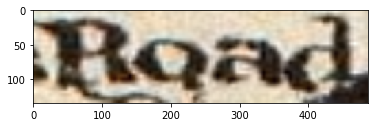

the matched words are (inorder): ['Road']
ground truth: Road
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


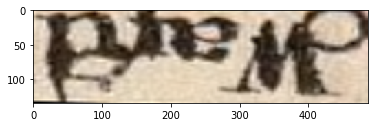

the matched words are (inorder): ['MAP']
ground truth: Ward
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


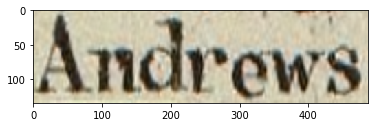

the matched words are (inorder): ['Andrews']
ground truth: Andrews
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


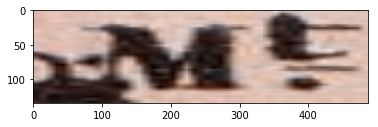

the matched words are (inorder): ['SANYBEL']
ground truth: Mt.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


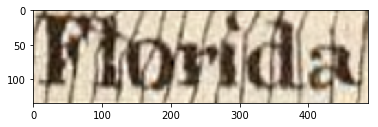

the matched words are (inorder): ['ROSA']
ground truth: Florida
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


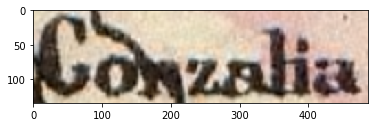

the matched words are (inorder): ['Gonzalia']
ground truth: Gonzalia
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


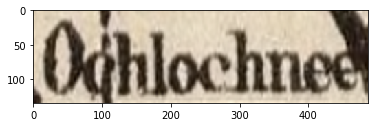

the matched words are (inorder): ['Ochlochnee']
ground truth: Ochlochnee
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


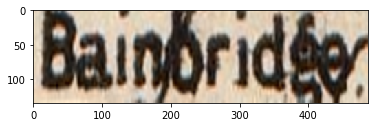

the matched words are (inorder): ['Bainbridge']
ground truth: Bainbridge
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


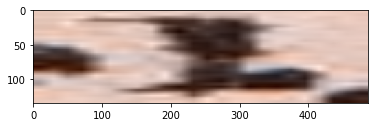

the matched words are (inorder): ['Alligator']
ground truth: unreadable
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


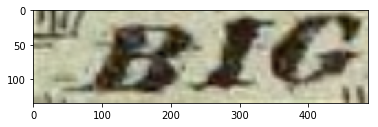

the matched words are (inorder): ['PINE']
ground truth: BIG
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


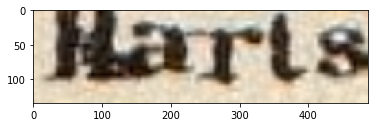

the matched words are (inorder): ['Harts']
ground truth: Harts
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


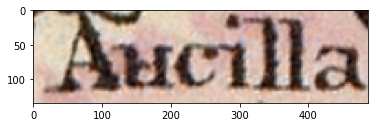

the matched words are (inorder): ['Aucilla']
ground truth: Aucilla
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


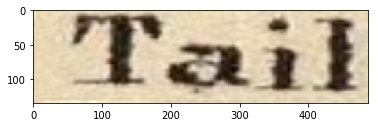

the matched words are (inorder): ['Tail']
ground truth: Tail
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


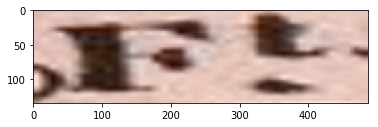

the matched words are (inorder): ['Barren']
ground truth: Ft.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


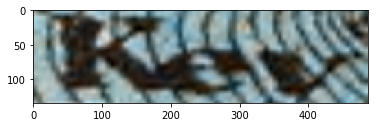

the matched words are (inorder): ['RIV.']
ground truth: Key
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


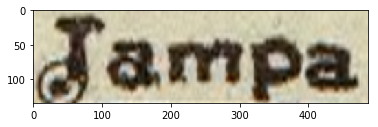

the matched words are (inorder): ['Tampa']
ground truth: Tampa
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


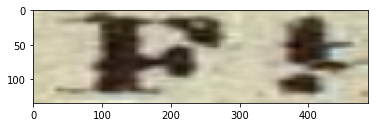

the matched words are (inorder): ['Reef']
ground truth: Ft.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


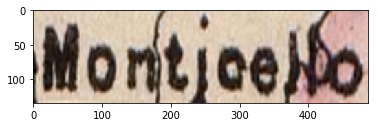

the matched words are (inorder): ['Monticello']
ground truth: Monticello
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


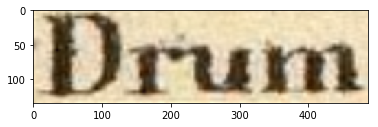

the matched words are (inorder): ['Dunns']
ground truth: Drum
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


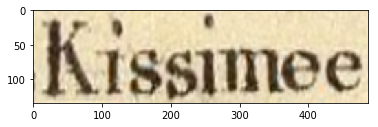

the matched words are (inorder): ['Kissimee']
ground truth: Kissimee
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


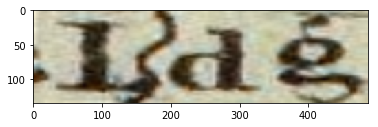

the matched words are (inorder): ['Ldg']
ground truth: Ldg
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


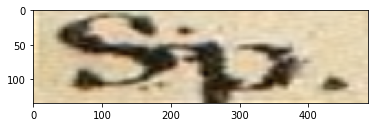

the matched words are (inorder): ['Still']
ground truth: Sp.
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


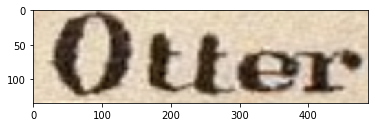

the matched words are (inorder): ['Otter']
ground truth: Otter
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


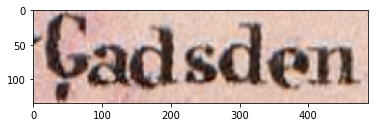

the matched words are (inorder): ['Gadsden']
ground truth: Gadsden
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


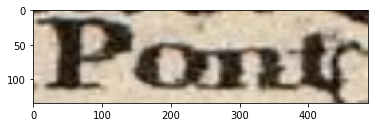

the matched words are (inorder): ['Pont']
ground truth: Pont
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


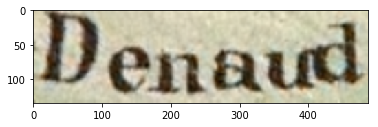

the matched words are (inorder): ['Denaud']
ground truth: Denaud
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


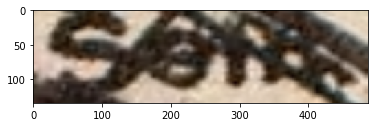

the matched words are (inorder): ['SUWANEE']
ground truth: unreadable
------------------------------------------------------------------------
------------------------------------------------------------------------
************************************************************************
************************************************************************
Original image:


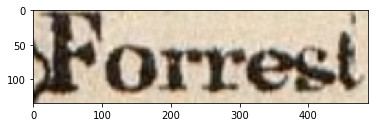

the matched words are (inorder): ['Forrest']
ground truth: Forrest
------------------------------------------------------------------------
------------------------------------------------------------------------


In [46]:
import matplotlib.pyplot as plt

count, matched_words, new_outputs, new_embedding, new_word_strings, \
    qualified_ids = report_matches(outputs, embedding, 'cosine', word_strings, 1, 2)

print A[2] + " the accuracy is: "+str(count/float(len(new_word_strings)))

_len = min(500, len(matched_words))
new_images = images[qualified_ids]
for i in range(_len):
    print "************************************************************************"
    print "************************************************************************"
    print "Original image:"
    q = np.transpose(new_images[i],(1,2,0))
    plt.imshow(q)
    plt.show()
    print "the matched words are (inorder): "+str(matched_words[i])
    print 'ground truth: ' + str(new_word_strings[i])
    print "------------------------------------------------------------------------"
    print "------------------------------------------------------------------------"
pass